## **Analysis of single-cell RNA-Seq data of _Macaca fascicularis_ spematogenesis (E-MTAB-8979)**
#### _**Author: Prabhakaran Munusamy**_

In [1]:
%config InlineBackend.figure_formats = ["retina"]
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib.colors
import seaborn as sns
from  more_itertools import unique_everseen
import scanpy as sc
sc.settings.verbosity = 3 
sc.logging.print_versions()
sc.settings.n_jobs = 16

scanpy==1.4.7.dev82+ge1cd0d8.d20200805 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.3 scikit-learn==0.22.1 statsmodels==0.11.0rc2 python-igraph==0.7.1 leidenalg==0.7.0


In [2]:
import anndata2ri
anndata2ri.activate()

In [3]:
%reload_ext rpy2.ipython

In [4]:
plt.rcParams.update({"font.family":"Reem Kufi"})
pd.set_option("display.max_rows", 100)
pd.set_option("display.max_columns", 100)

In [5]:
# Custom heatmap colors
heatcolors = matplotlib.colors.LinearSegmentedColormap.from_list("", ["gray", "#000004FF", "#330A5FFF", "#781C6DFF",
                                                                      "#BB3754FF", "#ED6925FF", 
                                                                      "#FCB519FF", "#FCFFA4FF"])

heatcolors_wr = matplotlib.colors.LinearSegmentedColormap.from_list("", ["white", "#FFF5F0", "#FEE0D2", "#FCBBA1", 
                                                                         "#FC9272", "#FB6A4A", "#EF3B2C", 
                                                                         "#CB181D", "#A50F15", "#67000D"])

In [6]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf", frameon=True)
sns.set_context("paper", font_scale=1, rc={"font.size":8,"axes.labelsize":8,"axes.titlesize":14})

In [7]:
%%R
# Load the libraries
suppressWarnings(suppressMessages(require(scran)))
suppressWarnings(suppressMessages(require(scater)))
suppressWarnings(suppressMessages(library(DropletUtils)))
suppressPackageStartupMessages(library(batchelor))
suppressPackageStartupMessages(library(ComplexHeatmap))
suppressPackageStartupMessages(library(circlize))
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(tidyverse))
options(mc.cores = 24L)

In [8]:
%%R
# Load the individual data
MUX8555 <- read10xCounts("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas1_count/outs/filtered_feature_bc_matrix/")
colData(MUX8555)$Sample <- rep("MUX8555", ncol(MUX8555))
MUX8990 <- read10xCounts("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas2_count/outs/filtered_feature_bc_matrix/")
colData(MUX8990)$Sample <- rep("MUX8990", ncol(MUX8990))
MUX8991 <- read10xCounts("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas3_count/outs/filtered_feature_bc_matrix/")
colData(MUX8991)$Sample <- rep("MUX8991", ncol(MUX8991))
MUX9780 <- read10xCounts("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas4_count/outs/filtered_feature_bc_matrix/")
colData(MUX9780)$Sample <- rep("MUX9780", ncol(MUX9780))
SSEA4 <- read10xCounts("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas4_SSEA4_count/outs/filtered_feature_bc_matrix/")
colData(SSEA4)$Sample <- rep("SSEA4", ncol(SSEA4))

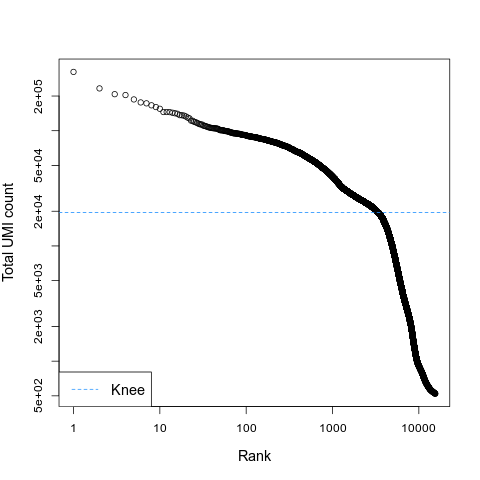

In [9]:
%%R
bcrank <- barcodeRanks(counts(MUX8555))
# Knee-point plots on the raw data

uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

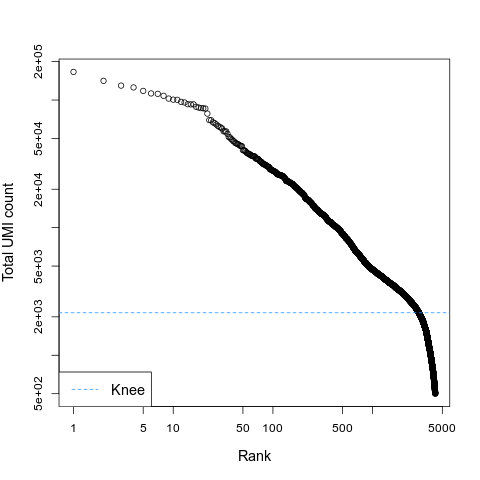

In [10]:
%%R
bcrank <- barcodeRanks(counts(MUX8990))

# Only showing unique points for plotting speed.
uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

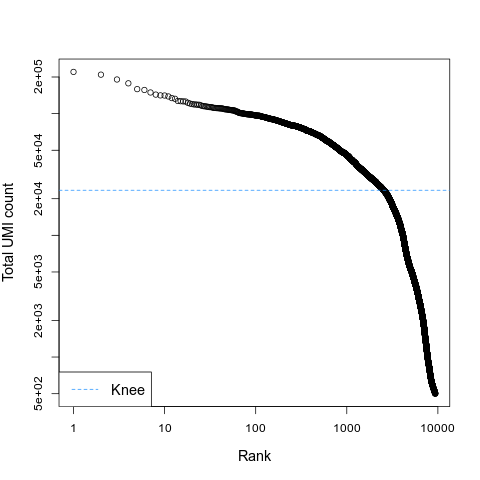

In [11]:
%%R
bcrank <- barcodeRanks(counts(MUX8991))

# Only showing unique points for plotting speed.
uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

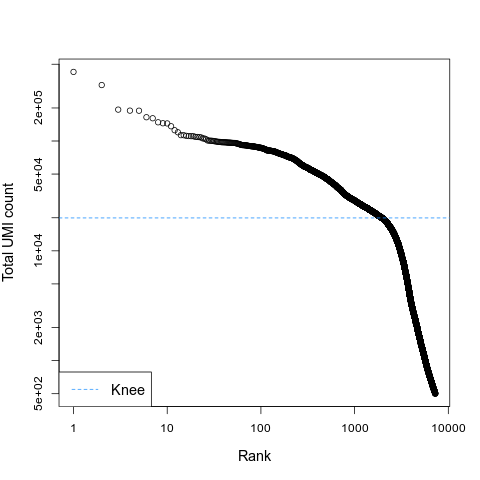

In [12]:
%%R
bcrank <- barcodeRanks(counts(MUX9780))

# Only showing unique points for plotting speed.
uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

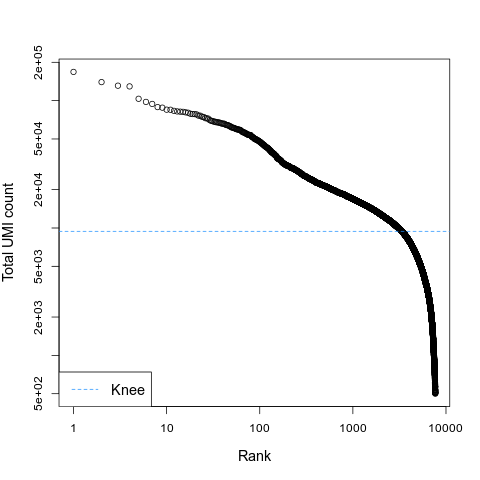

In [13]:
%%R
bcrank <- barcodeRanks(counts(SSEA4))

# Only showing unique points for plotting speed.
uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

In [14]:
%%R
# Merge all datasets
mf_sce <- cbind(MUX8555, MUX8990, MUX8991, MUX9780, SSEA4)
rownames(mf_sce) <- rowData(mf_sce)$Symbol
print(mf_sce)

class: SingleCellExperiment 
dim: 21892 44089 
metadata(5): Samples Samples Samples Samples Samples
assays(1): counts
rownames(21892): PGBD2 ZNF692 ... ENSMMUG00000040726 ENSMMUG00000045289
rowData names(3): ID Symbol Type
colnames: NULL
colData names(2): Sample Barcode
reducedDimNames(0):
spikeNames(0):
altExpNames(0):


Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


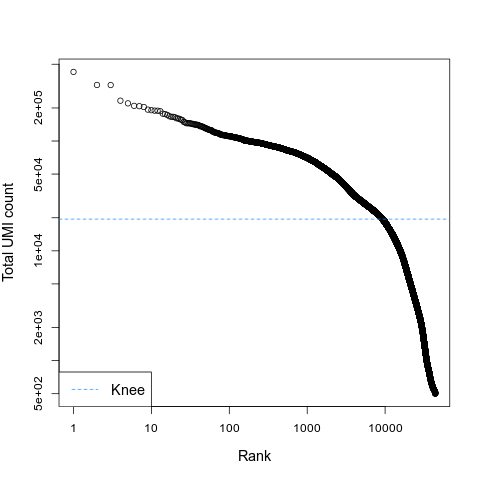

In [15]:
%%R
bcrank <- barcodeRanks(counts(mf_sce))

# Only showing unique points for plotting speed.
uniq <- !duplicated(bcrank$rank)
plot(bcrank$rank[uniq], bcrank$total[uniq], log="xy",
    xlab="Rank", ylab="Total UMI count", cex.lab=1.2)

abline(h=metadata(bcrank)$knee, col="dodgerblue", lty=2)

legend("bottomleft", legend=c("Knee"), 
        col=c("dodgerblue"), lty=2, cex=1.2)

In [16]:
%%R
MT.Genes <- c("ATP6", "ATP8", "COX1", "COX2", "COX3", "CYTB", "ND1", "ND2", "ND3", "ND4", "ND4L", "ND5", "ND6")
# Calculate QC metrics
mf_sce <- addPerCellQC(mf_sce, subsets = list(mt=MT.Genes))

# Remove low quality cells i.e., those with less than 200 genes expressed and less than 3500 UMI counts
mf_sce <- mf_sce[,mf_sce$detected > 200 & mf_sce$sum > 3500 & mf_sce$sum < 100000 & mf_sce$subsets_mt_percent < 20]

# Remove unxpressed genes 
mf_sce <- mf_sce[Matrix::rowSums(counts(mf_sce)) > 0, ]

Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [17]:
%%R
# Post mitochondrial content and UMI based filtering
print(mf_sce)

class: SingleCellExperiment 
dim: 20736 17792 
metadata(5): Samples Samples Samples Samples Samples
assays(1): counts
rownames(20736): PGBD2 ZNF692 ... ENSMMUG00000040726 ENSMMUG00000045289
rowData names(3): ID Symbol Type
colnames: NULL
colData names(12): Sample Barcode ... subsets_mt_percent total
reducedDimNames(0):
spikeNames(0):
altExpNames(0):


Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [18]:
%%R
# Normalization
set.seed(55063)
clusters <- quickCluster(mf_sce)
mf_sce <- computeSumFactors(mf_sce, cluster = clusters)
mf_sce <- logNormCounts(mf_sce)

# Identify HVGs
set.seed(55063)
mod_mf <- modelGeneVar(mf_sce)
hvgs_mf <- getTopHVGs(mod_mf, prop = 0.1)

# Dimensionality reduction
set.seed(55063)
mf_sce <- runPCA(mf_sce, subset_row = hvgs_mf)
mf_sce <- runTSNE(mf_sce, dimred = "PCA", num_threads = 24, verbose = F)

Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [19]:
%%R
# Perform Batch correction
# Identify HVGs accounting for different samples
set.seed(55063)
mod_mf_batch <- modelGeneVar(mf_sce, block = colData(mf_sce)$Sample)
hvgs_mf_batch <- getTopHVGs(mod_mf_batch, prop = 0.1)

set.seed(55063)
mf_sce_corrected <- fastMNN(mf_sce, subset.row = hvgs_mf_batch, batch=mf_sce$Sample)

set.seed(55063)
mf_sce_corrected <- runTSNE(mf_sce_corrected, dimred = "corrected", perplexity=300, num_threads = 12, verbose = F)
reducedDim(mf_sce, "mnn") <- reducedDim(mf_sce_corrected, "corrected")
reducedDim(mf_sce, "mnnTSNE") <- reducedDim(mf_sce_corrected, "TSNE")

In [20]:
%%R -o mf_sce
# Number of HVGs used for batch correction
length(hvgs_mf_batch)

[1] 828


Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [21]:
mf_sce.var_names_make_unique()

In [22]:
mf_sce.obs['Library'] = mf_sce.obs['Sample']

In [23]:
mf_sce.obs['batch'] = mf_sce.obs['Library'].replace({
    "MUX8555":"-0",
    "MUX8990": "-1",
    "MUX8991": "-2",
    "MUX9780": "-3",
    "SSEA4": "-4"
})

In [24]:
mf_sce.obs['Sample'] = mf_sce.obs['Library'].replace({
    "MUX8555":"Adult1",
    "MUX8990": "Infant",
    "MUX8991": "Juvenile",
    "MUX9780": "Adult2",
    "SSEA4": "Adult2_SSEA4+"
})

In [25]:
mf_sce.obs.index = mf_sce.obs['Barcode']+mf_sce.obs['batch']

In [26]:
mf_sce.obs['Sample'].value_counts() # Number of cells in each animal

Adult1           5911
Juvenile         4148
Adult2           3665
Adult2_SSEA4+    3206
Infant            862
Name: Sample, dtype: int64

In [27]:
mf_sce.obs['sum'].mean() # Mean of UMI counts across all cells

22131.387196492808

In [28]:
mf_sce.obs['sum'].describe() # Descriptive statistics of UMI counts across all cells

count    17792.000000
mean     22131.387196
std      18881.270479
min       3501.000000
25%       8302.750000
50%      17446.000000
75%      27485.000000
max      99926.000000
Name: sum, dtype: float64

In [29]:
mf_sce.obs['detected'].mean() # Mean of genes detected across all cells

3535.5954923561153

In [30]:
mf_sce.obs['detected'].describe() # Descriptive statistics of genes detected across all cells

count    17792.000000
mean      3535.595492
std       1418.207950
min        556.000000
25%       2239.750000
50%       3735.000000
75%       4535.000000
max       8601.000000
Name: detected, dtype: float64

In [31]:
mf_sce.obs["Sample"] = mf_sce.obs["Sample"].astype("category").cat.reorder_categories(["Infant", "Juvenile", "Adult1", "Adult2", "Adult2_SSEA4+"],ordered=True)

... storing 'Barcode' as categorical
... storing 'Library' as categorical
... storing 'batch' as categorical
... storing 'Symbol' as categorical
... storing 'Type' as categorical


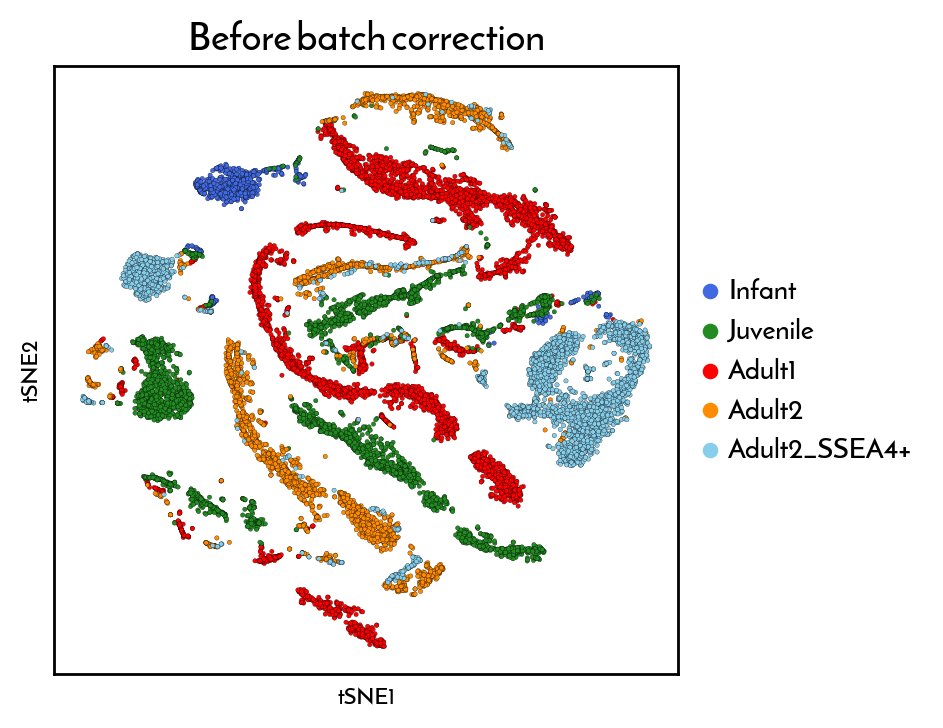

In [32]:
sc.pl.tsne(mf_sce, color = ["Sample"], palette=["royalblue", "forestgreen", "red", "darkorange", "skyblue"],
           size = 10, 
           edgecolor = "black", 
           linewidths = 0.1,
           ncols = 2, 
           legend_fontsize = 10,legend_loc="right margin", title="Before batch correction")

In [33]:
mf_sce.obsm['X_tsne'] = mf_sce.obsm['mnnTSNE']

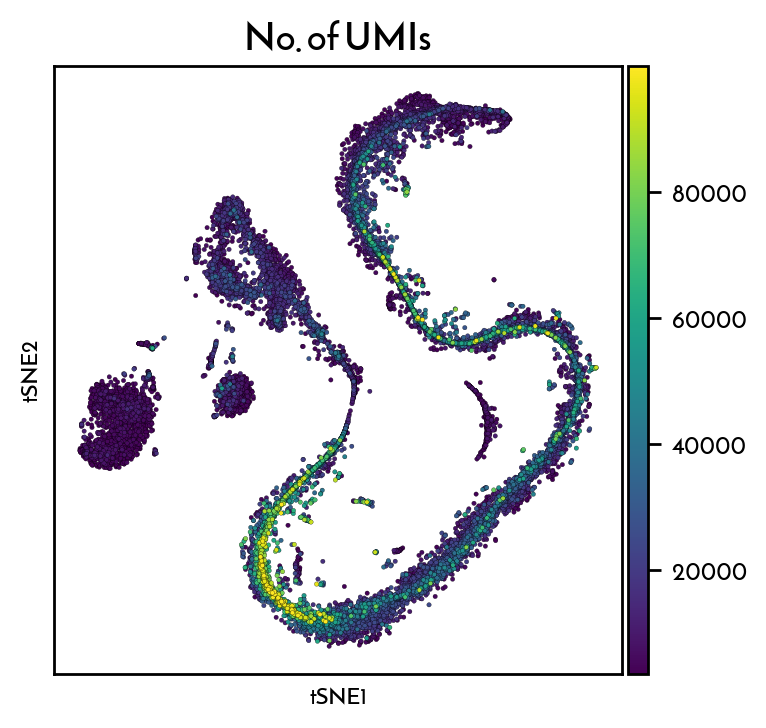

In [34]:
sc.pl.tsne(mf_sce, color = ["sum"], 
           size = 10, 
           edgecolor = "black", cmap = "viridis",
           linewidths = 0.1,
           ncols = 2, 
           legend_fontsize = 10,  legend_loc="right margin", title="No. of UMIs")

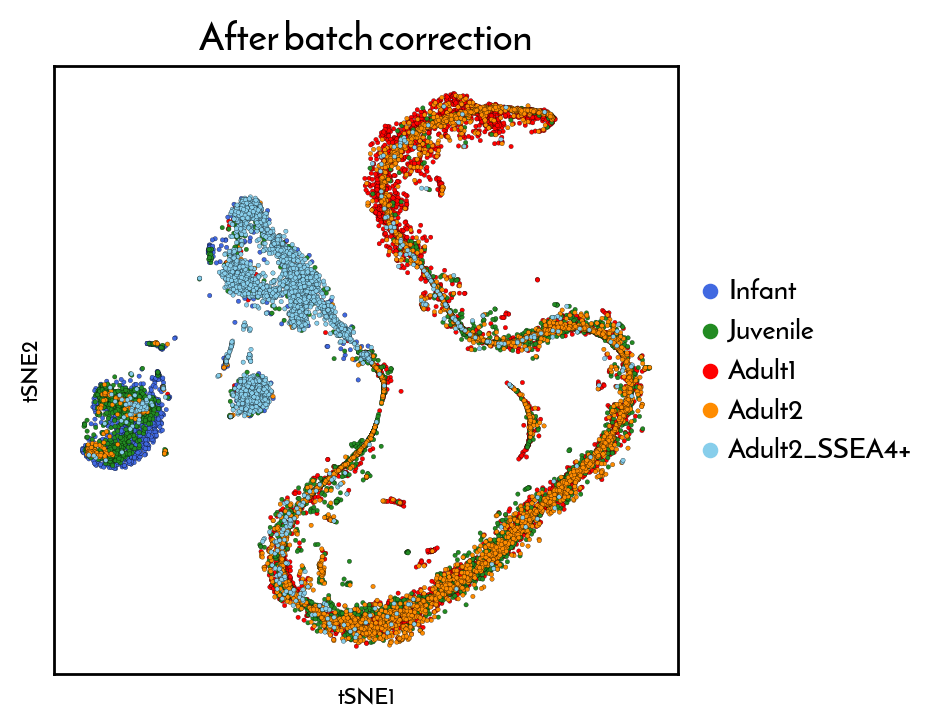

In [35]:
sc.pl.tsne(mf_sce, color = ["Sample"], 
           size = 10, 
           edgecolor = "black", 
           linewidths = 0.1,
           ncols = 2, 
           legend_fontsize = 10,  legend_loc="right margin", title="After batch correction")

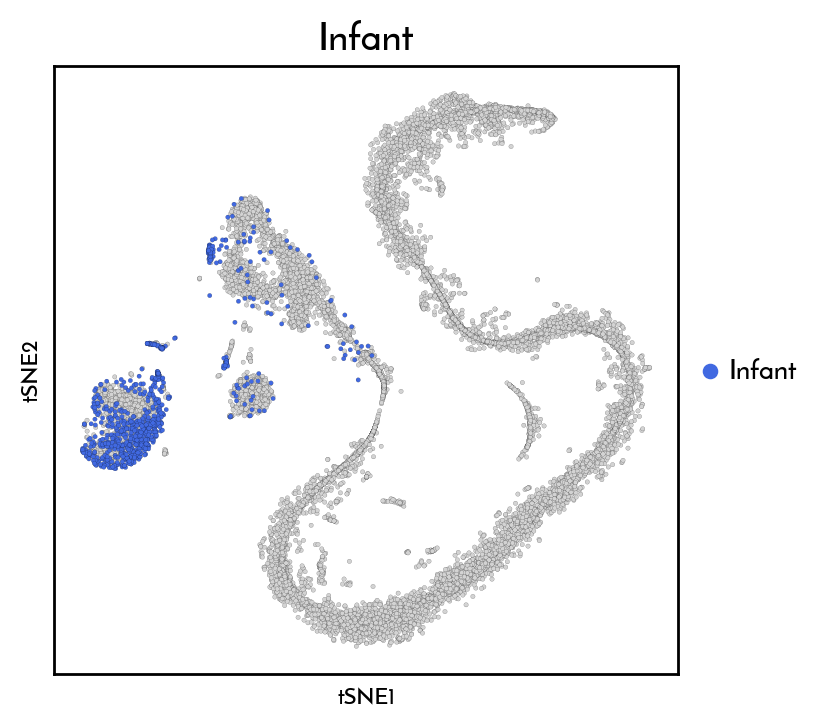

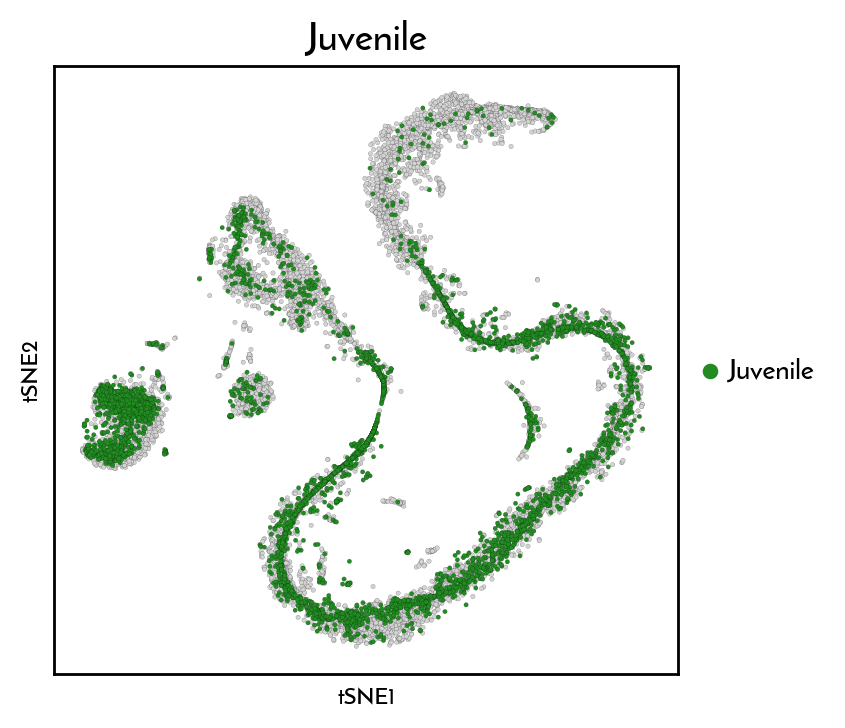

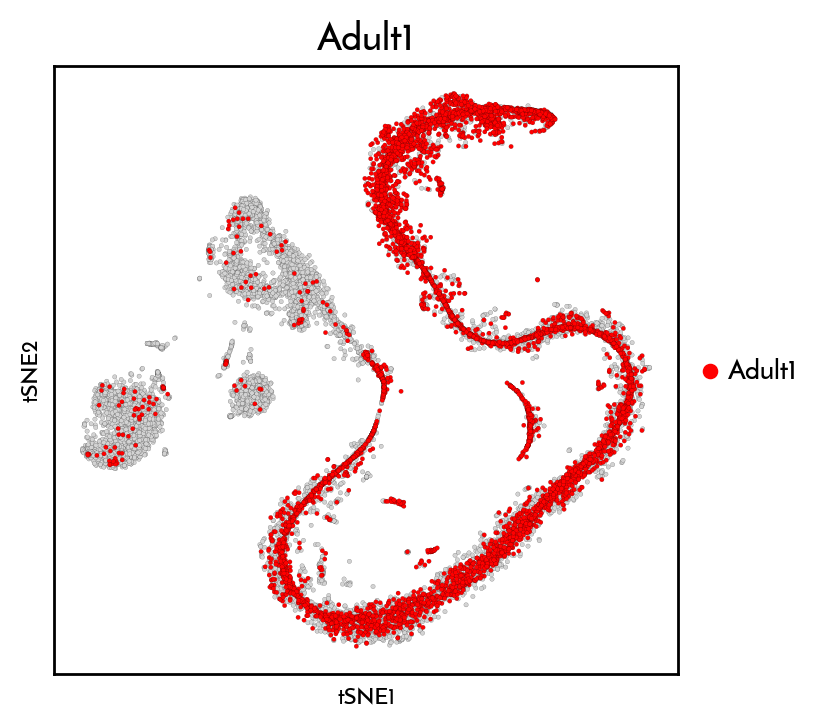

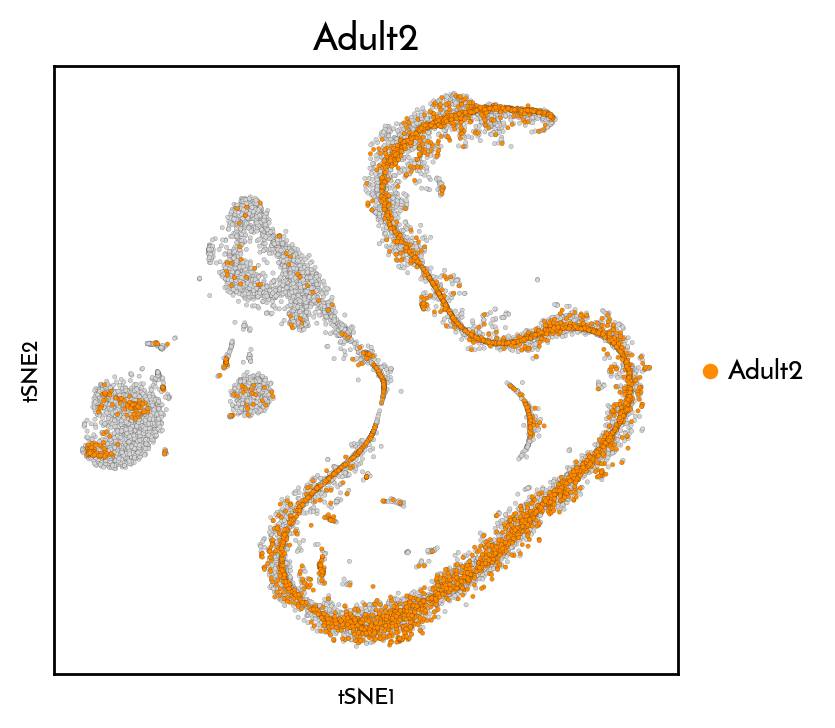

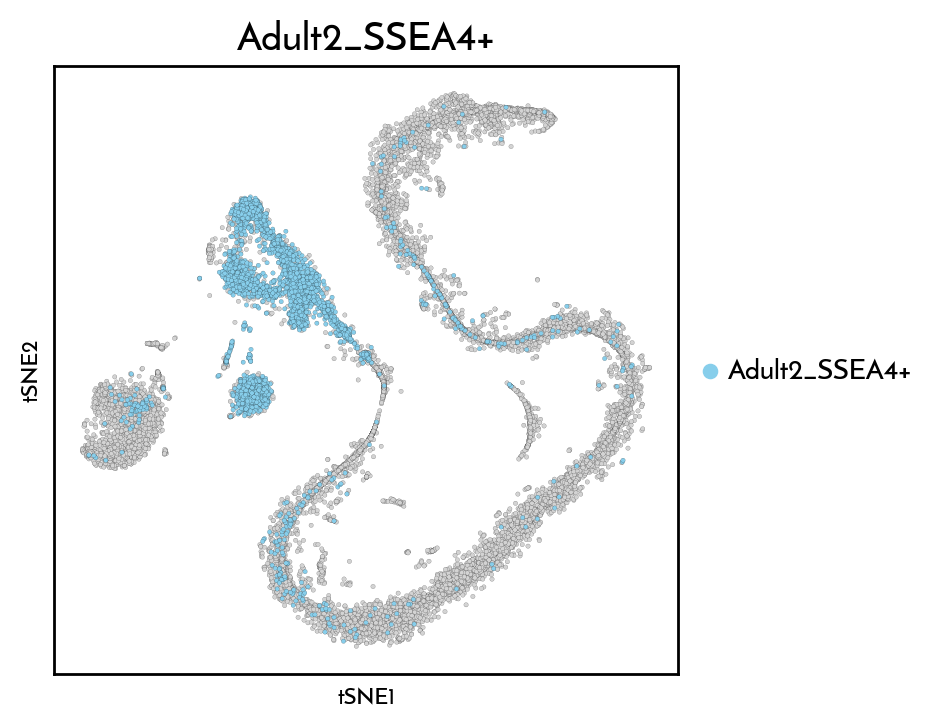

In [36]:
for s in ["Infant", "Juvenile", "Adult1", "Adult2", "Adult2_SSEA4+"]:
    sc.pl.tsne(mf_sce, color=[ "Sample"], palette=["royalblue", "forestgreen", "red", "darkorange", "skyblue"],
               groups=s,size=10, edgecolor="black", linewidths=0.05, ncols=1, legend_fontsize=10, cmap="viridis",
               legend_fontoutline=1,  title=s)

In [37]:
mf_sce.obsm["X_pca"] = mf_sce.obsm["mnn"]

In [38]:
sc.pp.neighbors(mf_sce, n_neighbors = 5)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)


In [39]:
sc.tl.leiden(mf_sce, resolution = 2, key_added = 'leiden_2')

running Leiden clustering
    finished: found 54 clusters and added
    'leiden_2', the cluster labels (adata.obs, categorical) (0:00:04)


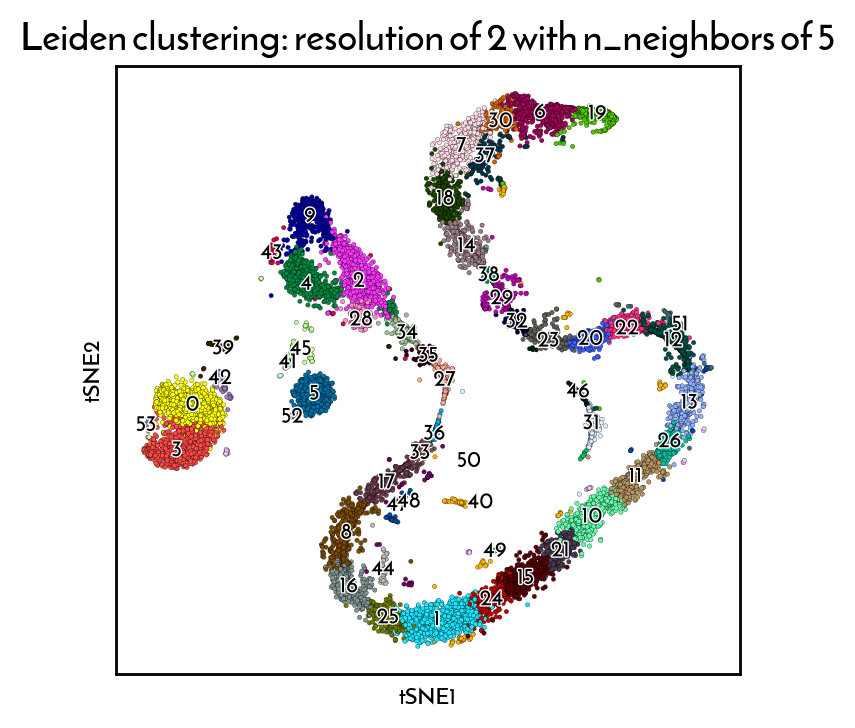

In [40]:
sc.pl.tsne(mf_sce, color=["leiden_2"], size=10, legend_loc = "on data", edgecolor = "black", linewidths = 0.1, ncols = 3, 
           legend_fontsize = 8, alpha=1,  legend_fontoutline=1,
           title="Leiden clustering: resolution of 2 with n_neighbors of 5")

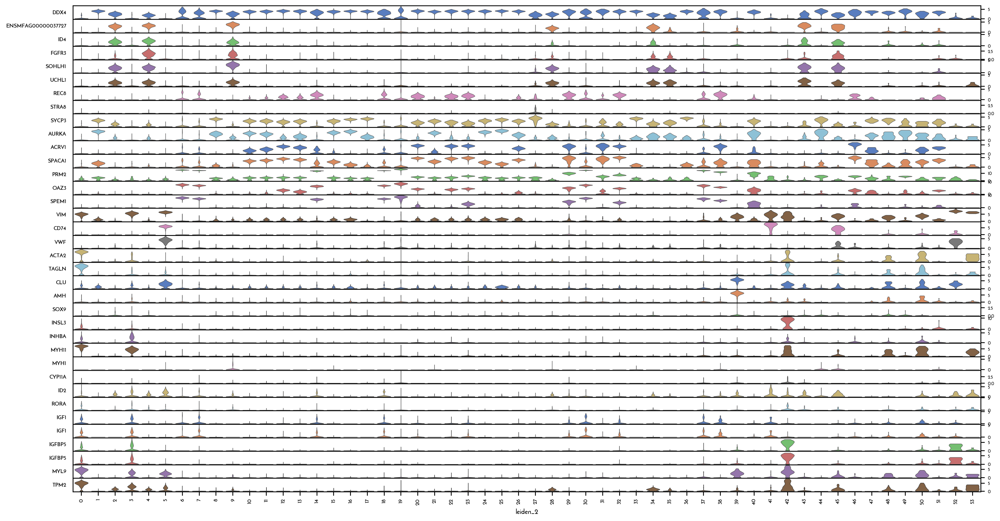

In [41]:
wv = sc.pl.stacked_violin(mf_sce, var_names=["DDX4", "ENSMFAG00000037727", "ID4", "FGFR3", "SOHLH1", "UCHL1", "REC8",
                                             "STRA8", "SYCP3", "AURKA","ACRV1", "SPACA1", "PRM2","OAZ3", "SPEM1", "VIM",
                                             "CD74", "VWF", "ACTA2", "TAGLN", "CLU", "AMH", "SOX9","INSL3", "INHBA", "MYH11",
                                             "MYH1", "CYP11A", "ID2", "RORA", "IGF1", "IGF1", "IGFBP5", "IGFBP5", "MYL9", "TPM2"],
                    groupby="leiden_2", swap_axes=True, layer="logcounts")

In [42]:
mf_sce.obs['broadcluster'] = mf_sce.obs['leiden_2']

mf_sce.obs['broadcluster'] = mf_sce.obs['broadcluster'].astype('str')

In [43]:
mf_sce.obs['broadcluster'][mf_sce.obs['broadcluster'].isin(["0", "3", "5", "39", "41", "42"])]="Somatic"
mf_sce.obs['broadcluster'][mf_sce.obs['broadcluster'].isin(["31", "37", "40", "44", "45", "46", "47", "48", "49", "50", "51", "52", "53"])] = "Outliers"
mf_sce.obs['broadcluster'][~mf_sce.obs['broadcluster'].isin(["Outliers", "Somatic"])] = "Germ"

... storing 'broadcluster' as categorical


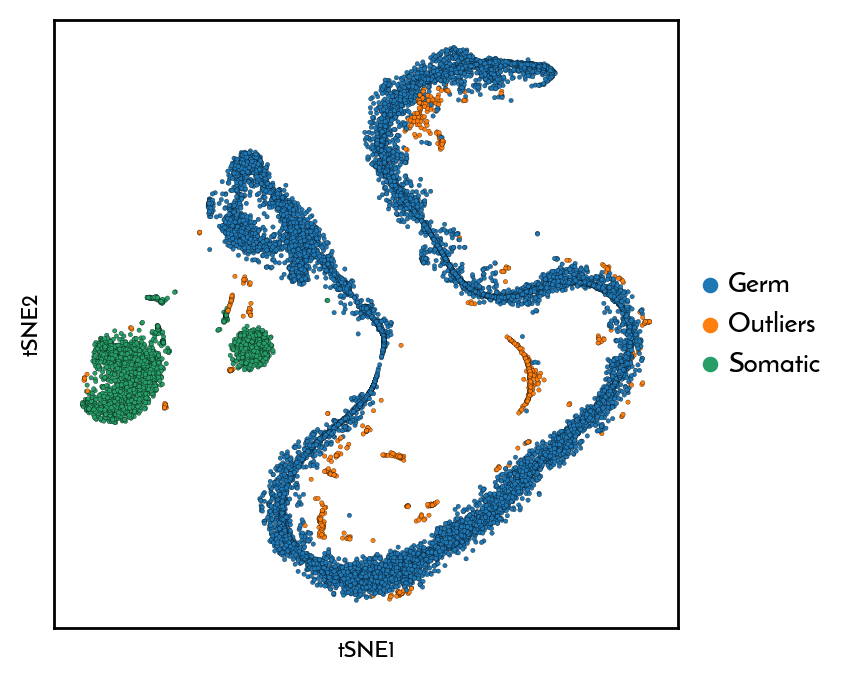

In [44]:
sc.pl.tsne(mf_sce, color=["broadcluster"], 
           size=10,
           edgecolor = "black", 
           linewidths = 0.1,
           legend_fontsize = 10, 
           alpha=1,  title="")

In [45]:
mf_leiden_clusters = mf_sce.obs['leiden_2'] # Save the cluster info to a variable and export it to R #do not re-run after clusters are called -> i.e. for the next step to be stable

In [46]:
%%R -i mf_leiden_clusters
mf_sce$mf_leiden_clusters = mf_leiden_clusters
mf_sce$broadcluster <- as.character(mf_sce$mf_leiden_clusters)

In [47]:
%%R
# Based on marker gene expression, assign identity to the cells i.e., Germ, somatic, and outliers
mf_sce$broadcluster[mf_sce$broadcluster %in% c("0", "3", "5", "39", "41", "42")] = "Somatic"

mf_sce$broadcluster[mf_sce$broadcluster %in% c("31", "37", "40", "44", "45", "46", "47", "48", "49", "50", "51", "52", "53")] = "Outliers"

mf_sce$broadcluster[!mf_sce$broadcluster %in% c("Outliers", "Somatic")] = "Germ"

## *Analysis of Macaque germ and somatic cells*

In [48]:
%%R -o mf_sce_gs
# Exclude the Outlier cells and perform batch correction
mf_sce_gs <- mf_sce[,mf_sce$broadcluster!="Outliers"]
mf_sce_gs <- mf_sce_gs[Matrix::rowSums(counts(mf_sce_gs)) > 0, ]
mf_sce_gs$mf_leiden_clusters <- factor(mf_sce_gs$mf_leiden_clusters)

# Identify HVGs based on sample
set.seed(55063)
mod_mf_batch_gs <- modelGeneVar(mf_sce_gs, block=colData(mf_sce_gs)$Sample)
hvgs_mf_batch_gs <- getTopHVGs(mod_mf_batch_gs, prop=0.1)
print(paste("HVGs used:",length(hvgs_mf_batch_gs)))

set.seed(55063)
mf_sce_gs_corrected <- fastMNN(mf_sce_gs, subset.row=hvgs_mf_batch_gs, batch=mf_sce_gs$Sample)
reducedDim(mf_sce_gs, "mnn") <- reducedDim(mf_sce_gs_corrected, "corrected")
mf_sce_gs$mf_leiden_clusters <- as.character(mf_sce_gs$mf_leiden_clusters)

[1] "HVGs used: 896"


Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [49]:
mf_sce_gs.var_names_make_unique()

In [50]:
mf_sce_gs.obs['Library'] = mf_sce_gs.obs['Sample']

mf_sce_gs.obs['batch'] = mf_sce_gs.obs['Library'].replace({
    "MUX8555":"-0",
    "MUX8990": "-1",
    "MUX8991": "-2",
    "MUX9780": "-3",
    "SSEA4": "-4"
})

mf_sce_gs.obs['Sample'] = mf_sce_gs.obs['Library'].replace({
    "MUX8555":"Adult1",
    "MUX8990": "Infant",
    "MUX8991": "Juvenile",
    "MUX9780": "Adult2",
    "SSEA4": "Adult2_SSEA4+"
})
mf_sce_gs.obs.index = mf_sce_gs.obs['Barcode']+mf_sce_gs.obs['batch']

In [51]:
mf_sce_gs.obs["Sample"] = mf_sce_gs.obs["Sample"].astype("category").cat.reorder_categories(["Infant", "Juvenile", "Adult1", "Adult2", "Adult2_SSEA4+"],ordered=True)

In [52]:
mf_sce_gs.obs['sum'].describe() #Descriptive statistics of UMI counts across all cells excluding outliers

count    16932.000000
mean     22385.195015
std      18842.843453
min       3501.000000
25%       8727.750000
50%      17798.500000
75%      27655.000000
max      99926.000000
Name: sum, dtype: float64

In [53]:
mf_sce_gs.obs['detected'].describe() #Descriptive statistics of genes detected across all cells excluding outliers

count    16932.000000
mean      3556.364222
std       1405.482717
min        556.000000
25%       2304.000000
50%       3777.000000
75%       4539.000000
max       8601.000000
Name: detected, dtype: float64

In [54]:
mf_sce_gs.obsm['X_tsne']=mf_sce_gs.obsm['mnnTSNE']

mf_sce_gs.obsm['X_pca']=mf_sce_gs.obsm['mnn']

... storing 'Barcode' as categorical
... storing 'mf_leiden_clusters' as categorical
... storing 'broadcluster' as categorical
... storing 'Library' as categorical
... storing 'batch' as categorical
... storing 'Symbol' as categorical
... storing 'Type' as categorical


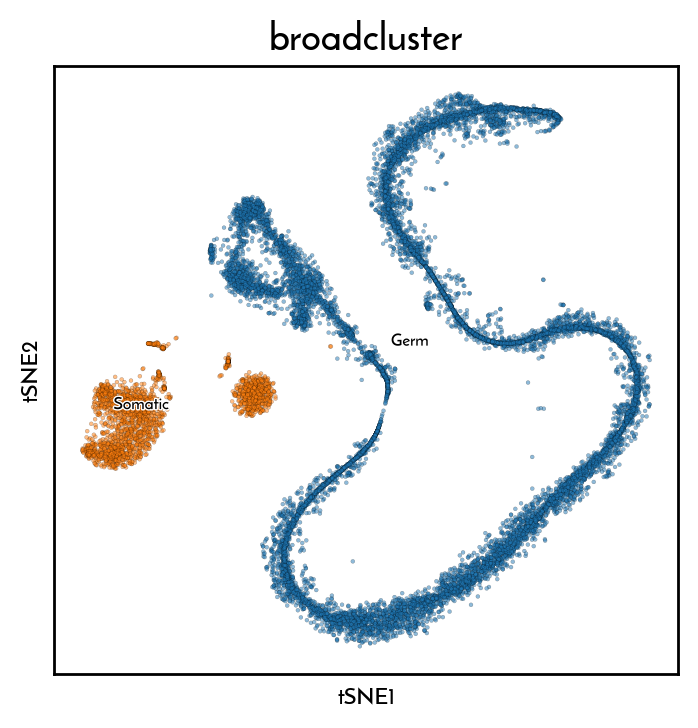

In [55]:
sc.pl.tsne(mf_sce_gs, color=["broadcluster"], size=8, 
           legend_loc="on data", edgecolor="black", linewidths=0.1, ncols=3, legend_fontsize=6, alpha=0.5, legend_fontoutline=1)

In [56]:
sc.tl.dendrogram(mf_sce_gs, groupby="mf_leiden_clusters")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_mf_leiden_clusters']`


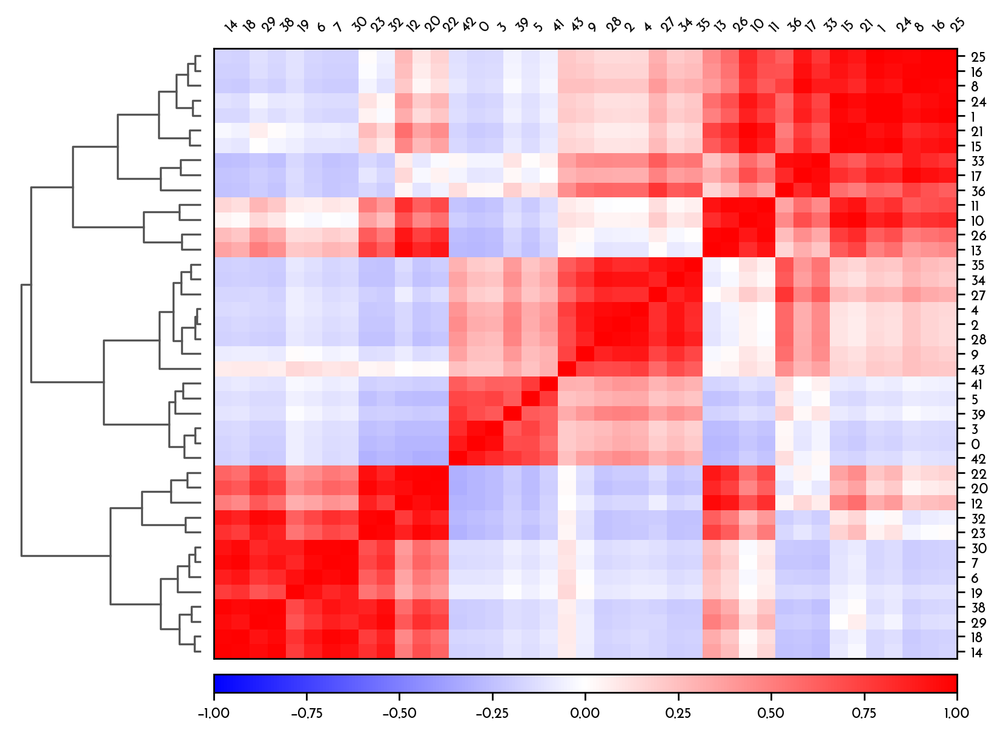

In [57]:
sc.pl.correlation_matrix(mf_sce_gs, groupby="mf_leiden_clusters", figsize=(10,7))

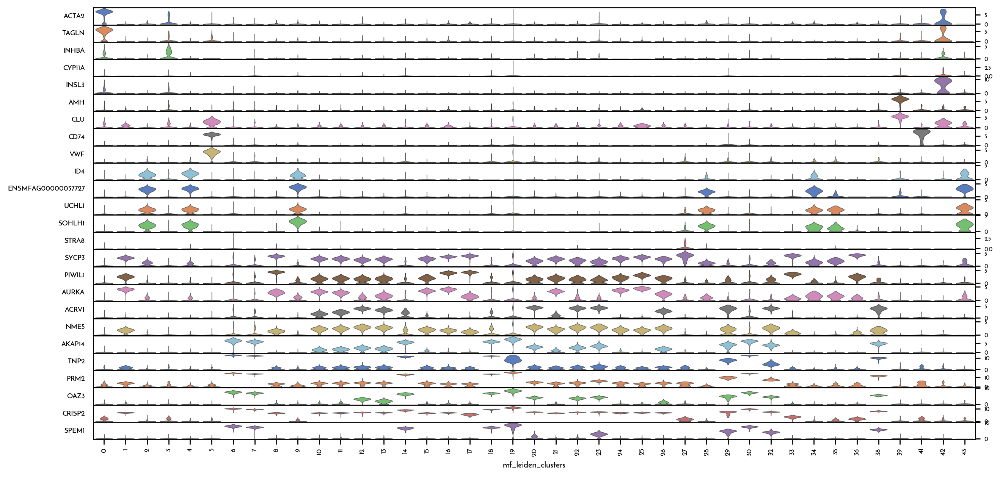

In [58]:
sc.pl.stacked_violin(mf_sce_gs, groupby="mf_leiden_clusters", 
                     var_names=["ACTA2", "TAGLN", "INHBA","CYP11A", "INSL3", "AMH",
                                "CLU", "CD74", "VWF", "ID4", "ENSMFAG00000037727", "UCHL1", "SOHLH1", "STRA8",
                                "SYCP3", "PIWIL1", "AURKA", "ACRV1", "NME5", "AKAP14", "TNP2", "PRM2", "OAZ3", "CRISP2", "SPEM1"],
                     swap_axes=True, layer="logcounts");           

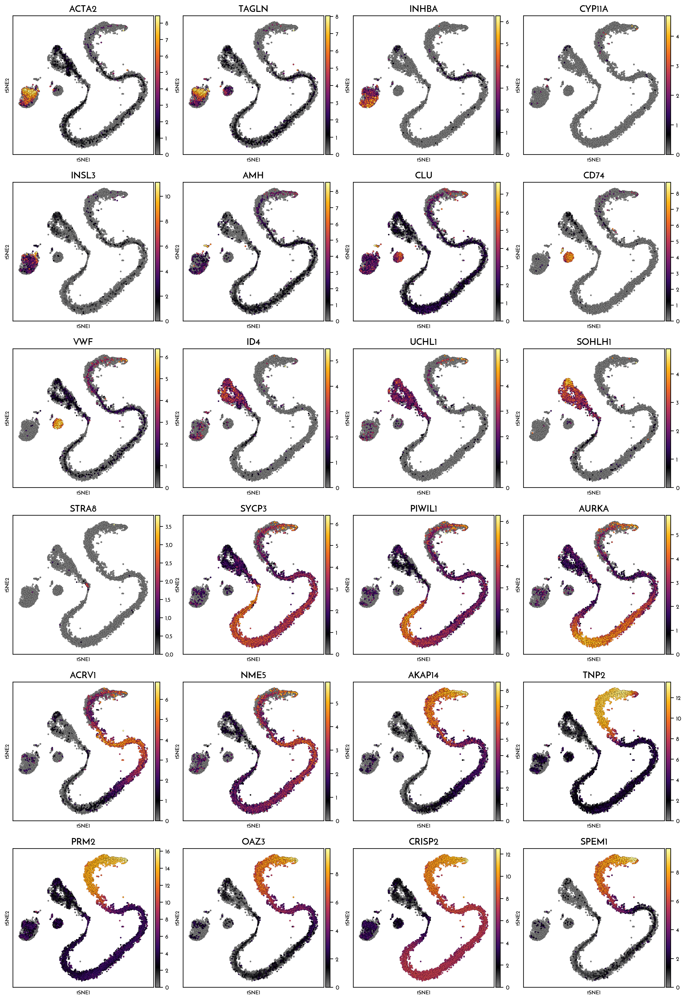

In [59]:
sc.pl.tsne(mf_sce_gs, color=["ACTA2", "TAGLN", "INHBA","CYP11A", "INSL3", "AMH", "CLU", "CD74", "VWF", 
                             "ID4", "UCHL1", "SOHLH1", "STRA8", "SYCP3", "PIWIL1", "AURKA", "ACRV1", "NME5",
                             "AKAP14", "TNP2", "PRM2", "OAZ3", "CRISP2", "SPEM1"], 
           legend_fontsize=8, color_map=heatcolors, 
           size=20, edgecolor="black", linewidths=0.1, ncols=4, layer="logcounts", wspace=0.1, hspace=0.2)

In [60]:
gsconditions = [
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["0"])),#Myoid
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["3"])),#Immature Leydig
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["42"])),#Leydig
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["39"])),#Sertoli
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["41"])),#Macrophage
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["5"])),#Endothelial
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["43", "9", "4", "28", "2", "34"])),#Spermatogonia
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["35", "27", "36", "33", "17","8", "16", 
                                               "25", "1", "24", "15", "21", "10", "11", "26"])),#Spermatocytes
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["13","12", "22", "20", "23", "32", "29"])),#Round spermatids
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["38", "14", "18", "7", "30", "6"])),#Elongating Spermatids
    (mf_sce_gs.obs["mf_leiden_clusters"].isin(["19"]))]#Sperm
gsgroups = ["Myoid", "Immature Leydig", "Leydig", "Sertoli", "Macrophage", "Endothelial", 
            "Spermatogonia", "Spermatocytes","Round spermatids","Elongating spermatids","Immature Sperm"]

In [61]:
gs_clusters = np.select(gsconditions, gsgroups, default="Germ")

In [62]:
mf_sce_gs.obs["broad_clusters"] = gs_clusters

In [63]:
mf_sce_gs.obs["broad_clusters"] = mf_sce_gs.obs["broad_clusters"].astype("category").cat.reorder_categories(["Myoid", "Immature Leydig", "Leydig", "Sertoli", "Macrophage", "Endothelial",
                                                                                                             "Spermatogonia", "Spermatocytes", "Round spermatids","Elongating spermatids","Immature Sperm"],ordered=True)

In [64]:
mf_sce_gs.obs['broad_clusters_short'] = mf_sce_gs.obs['broad_clusters']

In [65]:
mf_sce_gs.obs['broad_clusters_short'] = mf_sce_gs.obs['broad_clusters_short'].replace({
    "Round spermatids":"Round STids",
    "Elongating spermatids": "Elongating STids"
})

In [66]:
mf_sce_gs.obs['mf_leiden_clusters_celltype'] = mf_sce_gs.obs['mf_leiden_clusters'].astype(str) +"-"+mf_sce_gs.obs['broad_clusters_short'].astype(str)

In [67]:
mf_sce_gs.obs['mf_broadclusters_celltype_Sample'] = mf_sce_gs.obs['broad_clusters_short'].astype(str)+"-"+mf_sce_gs.obs['Sample'].astype(str)

In [68]:
cols_clusters = ["#FFB292","gold", "lightslategray", "#936C00","lime", "red", "#F16913",  "#4C7C5E", "#2171B5","#eaa9bd", "#91357d"]

... storing 'broad_clusters_short' as categorical
... storing 'mf_leiden_clusters_celltype' as categorical
... storing 'mf_broadclusters_celltype_Sample' as categorical


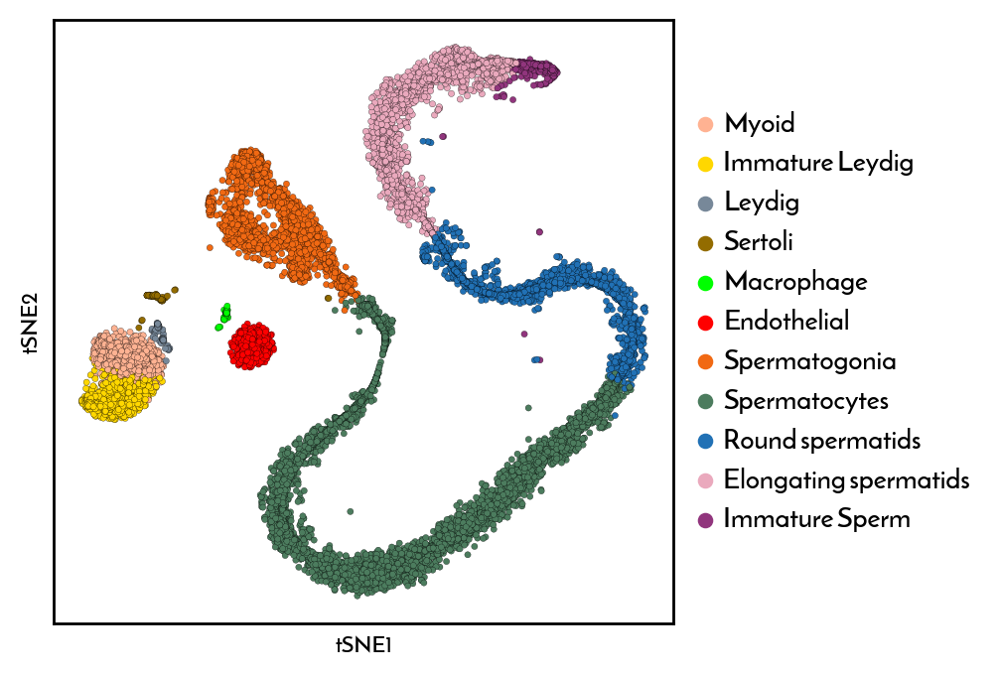

In [69]:
sc.pl.tsne(mf_sce_gs, color=["broad_clusters"], legend_fontsize=10, palette=cols_clusters, 
           size=20, edgecolor="black", linewidths=0.1, title="")

In [70]:
sc.tl.dendrogram(mf_sce_gs, groupby="mf_leiden_clusters_celltype")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_mf_leiden_clusters_celltype']`


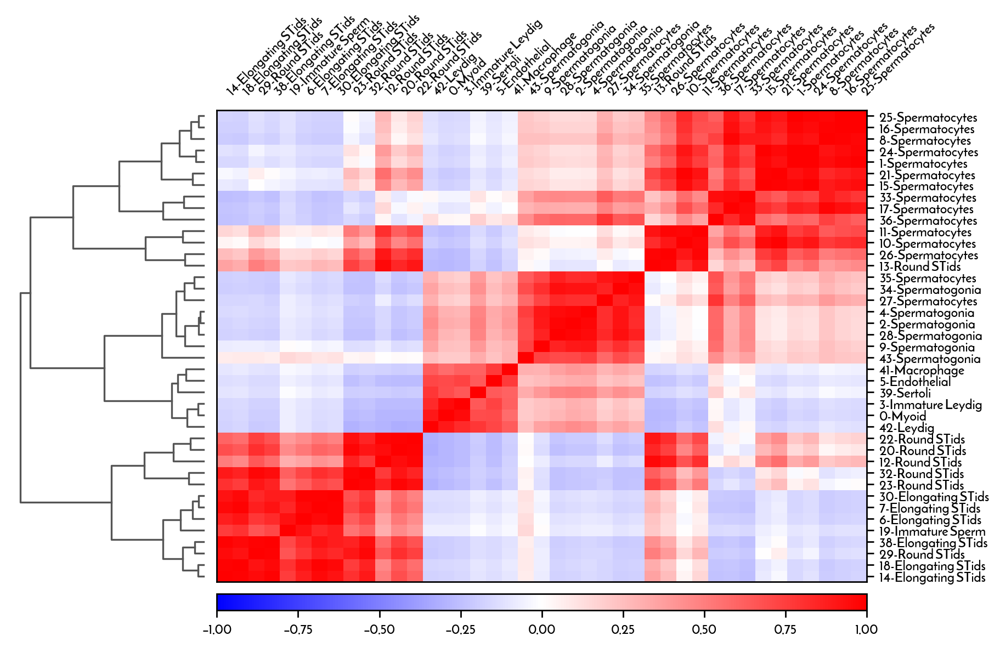

In [71]:
sc.pl.correlation_matrix(mf_sce_gs, groupby="mf_leiden_clusters_celltype", figsize=(10,6), dendrogram=True)

In [72]:
sc.tl.dendrogram(mf_sce_gs, groupby="mf_broadclusters_celltype_Sample")

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_mf_broadclusters_celltype_Sample']`


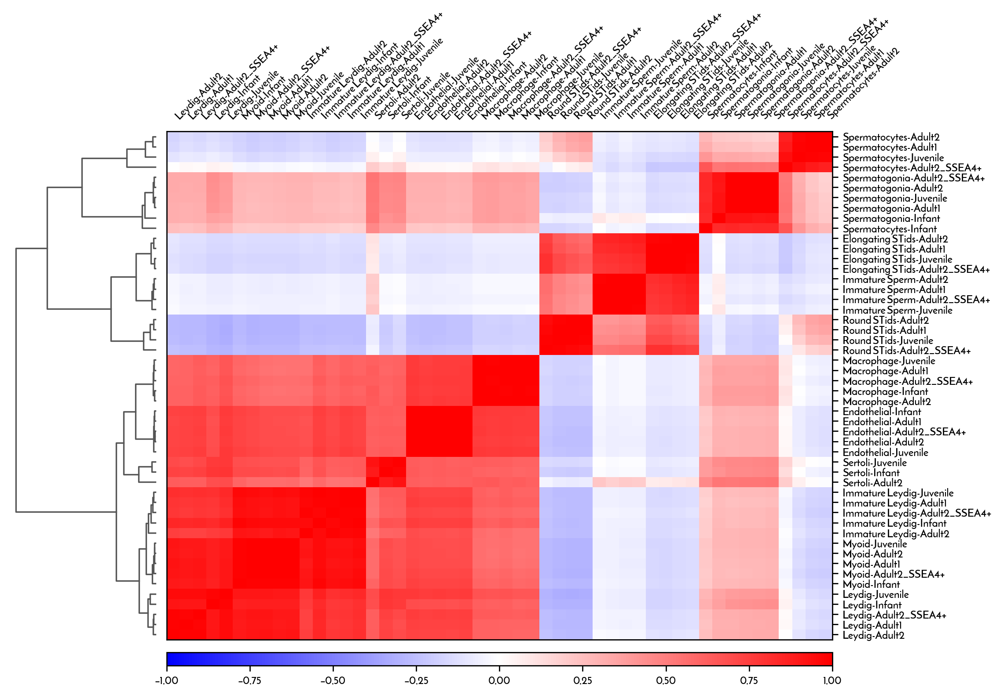

In [73]:
sc.pl.correlation_matrix(mf_sce_gs, groupby="mf_broadclusters_celltype_Sample", figsize=(12,8), dendrogram=True)

In [74]:
sc.tl.rank_genes_groups(mf_sce_gs, "broad_clusters", n_genes = 6000, method = "wilcoxon", layer = "logcounts", use_raw = False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:04)


In [75]:
gslist = {}
for i in mf_sce_gs.obs["broad_clusters"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_gs, group=i,pval_cutoff=0.01, log2fc_min=1.25, 
                                        key="rank_genes_groups").sort_values(by=["logfoldchanges"], ascending=[False]).dropna(axis=0)["names"].to_list()
    gslist[i] = genes

In [76]:
for key, value in gslist.items():
    #print value
    print(key, len([item for item in value if item]))

Myoid 1569
Immature Leydig 1285
Leydig 851
Sertoli 1093
Macrophage 863
Endothelial 2047
Spermatogonia 3297
Spermatocytes 3400
Round spermatids 2793
Elongating spermatids 2418
Immature Sperm 854


In [77]:
gs_L1 = []
for i in mf_sce_gs.obs["broad_clusters"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_gs, group=i,pval_cutoff=0.01, 
                                        log2fc_min=1.25, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    gs_L1.extend(genes) 

In [78]:
gs_unique_genes = list(unique_everseen(gs_L1))
len(gs_unique_genes)

12156

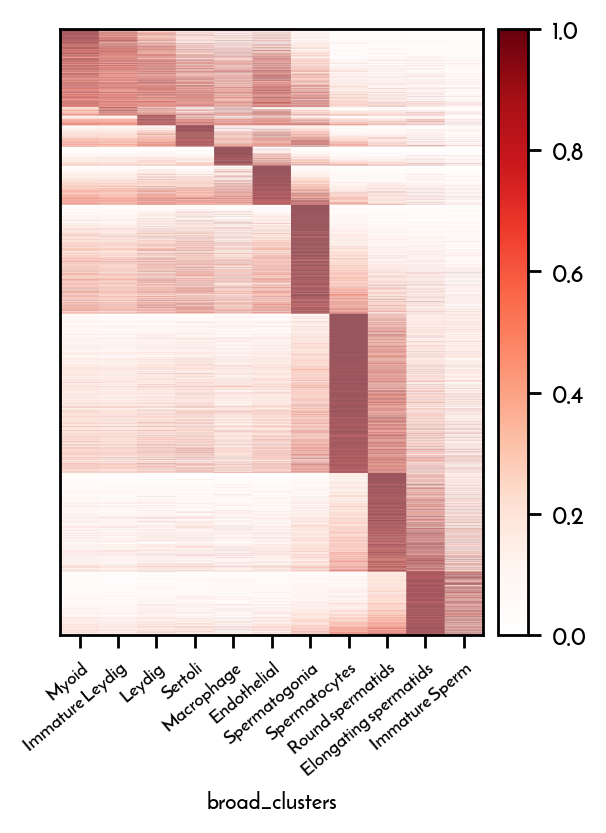

In [79]:
ax, mean = sc.pl.matrixplot(mf_sce_gs, gs_unique_genes, groupby="broad_clusters", figsize=(3, 4),
                            standard_scale="var", linewidth=.000001,swap_axes=True,
                            cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show=False,
                            show_gene_labels=False)

In [80]:
pd.crosstab(mf_sce_gs.obs['Sample'], mf_sce_gs.obs['broad_clusters'])

broad_clusters,Myoid,Immature Leydig,Leydig,Sertoli,Macrophage,Endothelial,Spermatogonia,Spermatocytes,Round spermatids,Elongating spermatids,Immature Sperm
Sample,,,,,,,,,,,
Infant,164,352,69,108,33,22,101,8,0,0,0
Juvenile,589,313,11,10,16,51,253,1903,722,89,10
Adult1,25,27,7,0,6,8,59,2268,1012,1781,303
Adult2,66,71,6,5,19,19,39,1672,783,661,127
Adult2_SSEA4+,55,9,7,0,38,539,2149,218,73,55,1


In [81]:
cellcounts = pd.crosstab( mf_sce_gs.obs['Sample'], mf_sce_gs.obs['broad_clusters'])

In [82]:
def reset_index(df):
    '''Returns DataFrame with index as columns'''
    index_df = df.index.to_frame(index=False)
    df = df.reset_index(drop=True)
    return pd.merge(index_df, df, left_index=True, right_index=True)

In [83]:
cellcounts = reset_index(cellcounts)

germ_cellcounts = cellcounts[['Sample', 'Spermatogonia','Spermatocytes', 'Round spermatids', 'Elongating spermatids','Immature Sperm']]

somatic_cellcounts = cellcounts[['Sample', 'Myoid', 'Immature Leydig', 'Leydig', 'Sertoli','Macrophage', 'Endothelial']]

In [84]:
germ_cellcounts.set_index('Sample', inplace=True)

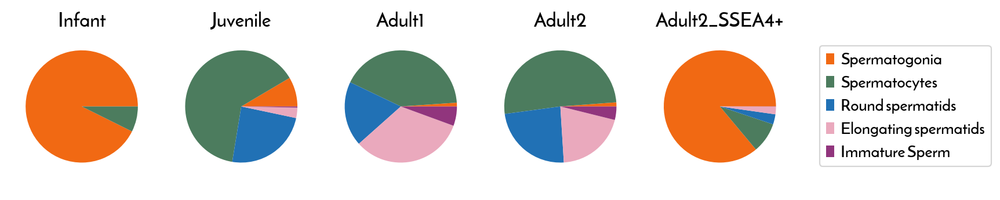

In [85]:
## Draw pie chart to show cell count distribution
germ_cellcounts = germ_cellcounts.div(germ_cellcounts.sum(axis=1), axis=0)

fig, axs = plt.subplots(ncols=germ_cellcounts.index.size, nrows=1, figsize=(7,2))

fig.subplots_adjust(hspace=0.5, wspace=0.05)
#l=[]
for row in range(germ_cellcounts.index.size):
    fig.add_subplot(axs[row] )
    plt.pie(germ_cellcounts.loc[germ_cellcounts.index[row],:],labels=None, colors=["#F16913",  "#4C7C5E", "#2171B5","#eaa9bd", "#91357d"])
    plt.title(germ_cellcounts.index[row], fontsize=12)
    #plt.axis('equal')
    plt.tight_layout()
    plt.axis('off')
fig.legend(germ_cellcounts.columns, ncol=1,loc='upper left', bbox_to_anchor=(1, 0.7), fontsize=10);

In [86]:
somatic_cellcounts.set_index('Sample', inplace=True)

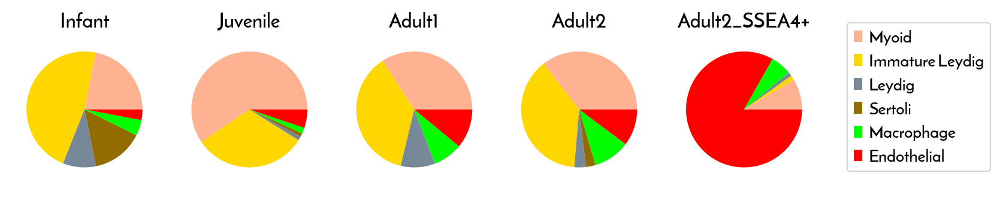

In [87]:
somatic_cellcounts = somatic_cellcounts.div(somatic_cellcounts.sum(axis=1), axis=0)

fig, axs = plt.subplots(ncols=somatic_cellcounts.index.size, nrows=1, figsize=(7,2))

fig.subplots_adjust(hspace=0.5, wspace=0.05)
#l=[]
for row in range(somatic_cellcounts.index.size):
    fig.add_subplot(axs[row] )
    plt.pie(somatic_cellcounts.loc[somatic_cellcounts.index[row],:],labels=None, colors=["#FFB292","gold", "lightslategray", "#936C00","lime", "red"])
    plt.title(somatic_cellcounts.index[row], fontsize=12)
    #plt.axis('equal')
    plt.tight_layout()
    plt.axis('off')
fig.legend(somatic_cellcounts.columns, ncol=1,loc='upper left', bbox_to_anchor=(1, 0.8), fontsize=10);

In [88]:
## GO term plot

In [89]:
sc.settings.set_figure_params(dpi=150, dpi_save=300, format="pdf", fontsize=8)

In [90]:
cols_clusters = ["gold","lightslategray", "lime", "#DAF7A6", "darkkhaki", "red", "#F16913",  "#4C7C5E", "#2171B5","#eaa9bd", "#91357d"]

In [91]:
GO_terms = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/17Apr_rev/Macaque/GO_terms_selected_28Apr.csv")

In [92]:
GO_terms['CellType'] = GO_terms['CellType'].replace({
    'Sperm': 'Immature Sperm'
})

In [93]:
GO_terms['-log10(p-value)'] = np.log10(GO_terms.p_value)*-1

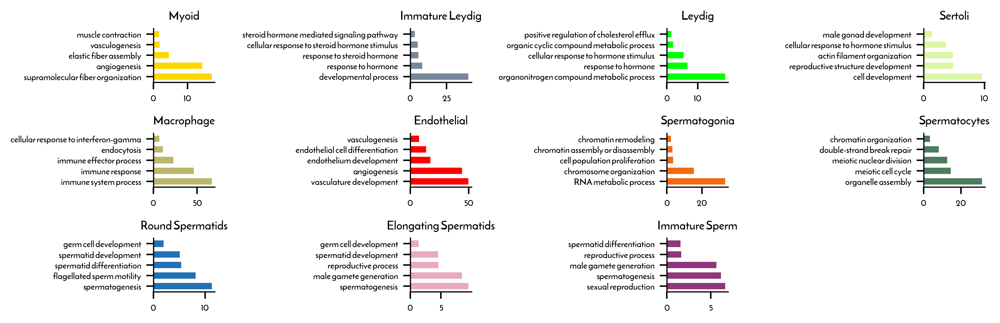

In [94]:
plt.rcParams['xtick.labelsize']=6
plt.rcParams['ytick.labelsize']=6
plt.rcParams['axes.grid']=False

go = sns.FacetGrid(GO_terms, col="CellType", sharex=False, sharey=False,hue="CellType", col_wrap=4, aspect=2.2, size=1.1, palette=cols_clusters)#For 3 = aspect=2.2, size=0.75, for 4 = aspect=2.8, size=0.9
go.map(plt.barh, "name", "-log10(p-value)", height=0.6).set_titles("").set_axis_labels("","").set_titles("{col_name}")#.set_tickparams(axis="both",  which="both", pad=0.01)#.set_xticklabels(length=0.1)#.set_titles("{col_name}").set_axis_labels("-log10(P)","")
go.fig.subplots_adjust(wspace=3.2, hspace=0.95)

In [95]:
mf_sce_gs.X = mf_sce_gs.layers["logcounts"]

In [96]:
# Load gene annnotation file
allgenes = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/gene_annotation.txt", index_col=0)

In [97]:
# Retrive chromosomes X, Y genes
chrX_genes = allgenes["Chromosome"]=="X"
chrY_genes = allgenes["Chromosome"]=="Y"

In [98]:
# Retrieve the X and Y genes detected in the dataset
Xgenes = set(allgenes[chrX_genes].index.tolist()).intersection(mf_sce_gs.var_names.tolist())
Ygenes = set(allgenes[chrY_genes].index.tolist()).intersection(mf_sce_gs.var_names.tolist())

In [99]:
mf_sce_gs.obs["ChrX percent"] = (np.sum(
    mf_sce_gs[:, list(Xgenes)].X, axis=1).A1 / np.sum(mf_sce_gs.X, axis=1).A1)*100

mf_sce_gs.obs["ChrY percent"] = (np.sum(
    mf_sce_gs[:, list(Ygenes)].X, axis=1).A1 / np.sum(mf_sce_gs.X, axis=1).A1)*100

In [100]:
# Make a dataframe using the selected columns
dist_data = mf_sce_gs.obs['broad_clusters'].to_frame().join(mf_sce_gs.obs['detected']).join(mf_sce_gs.obs['sum']).join(mf_sce_gs.obs['subsets_mt_percent']).join(mf_sce_gs.obs['ChrX percent']).join(mf_sce_gs.obs['ChrY percent'])
dist_data.columns = ['Clusters', 'No. of genes detected', 'UMI Count', '% Mito', '% ChrX', '% ChrY']
# Melt the data to long format
dist_data_melted = dist_data.melt(id_vars='Clusters', var_name='key', value_name='value')

In [101]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf")
# Set context to `"paper"`
sns.set_context("paper", font_scale=2, rc={"font.size":8,"axes.labelsize":8,"axes.titlesize":12})
plt.rcParams["axes.linewidth"] = 0.5

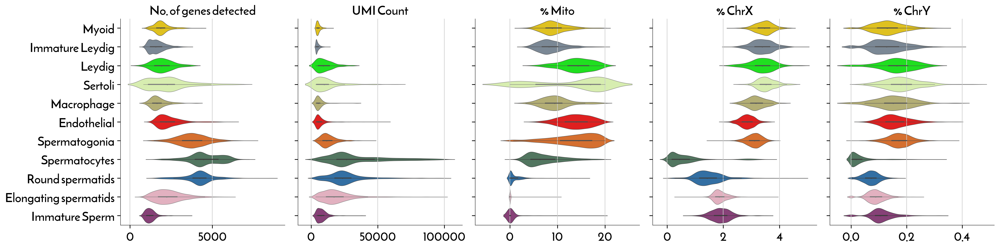

In [102]:
plt.rcParams["figure.titlesize"]=12
g = sns.FacetGrid(dist_data_melted, col="key", height=5, sharex=False, hue="Clusters", aspect=.8, palette=cols_clusters) 
g.map(sns.violinplot, "value", "Clusters", label='xxlarge', linewidth=0.5).set_titles("{col_name}", size=18).set_axis_labels("","")
g.fig.tight_layout()

In [103]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf", frameon=True)
# Set context to `"paper"`
sns.set_context("paper", font_scale=1, rc={"font.size":8,"axes.labelsize":8,"axes.titlesize":12})
plt.rcParams["axes.linewidth"] = 1

## *Focused analysis of macaque spermatogonial cells*

In [104]:
%%R -o mf_sce_germSPG
## Germ SPG
mf_sce_germSPG <- mf_sce_gs[,mf_sce_gs$mf_leiden_clusters %in% c('43', '9', '4', '28', '2', '34', '35', '27')]
mf_sce_germSPG <- mf_sce_germSPG[Matrix::rowSums(counts(mf_sce_germSPG)) > 0,]
mf_sce_germSPG$mf_leiden_clusters <- as.character(mf_sce_germSPG$mf_leiden_clusters)
mf_sce_germSPG$mf_leiden_clusters <- factor(mf_sce_germSPG$mf_leiden_clusters)

#Identify HVGs based on sample
set.seed(55063)
mod_mf_batch_germ_SPG <- modelGeneVar(mf_sce_germSPG, block=colData(mf_sce_germSPG)$Sample)
hvgs_mf_batch_germ_SPG <- getTopHVGs(mod_mf_batch_germ_SPG, prop=0.1)

set.seed(55063)
mf_sce_germ_SPG_corrected <- fastMNN(mf_sce_germSPG, subset.row=hvgs_mf_batch_germ_SPG, batch=mf_sce_germSPG$Sample)

set.seed(55063)
mf_sce_germ_SPG_corrected <- runTSNE(mf_sce_germ_SPG_corrected, dimred="corrected",
                                    verbose = F,
                                    num_threads = 24)
reducedDim(mf_sce_germSPG, "mnn") <- reducedDim(mf_sce_germ_SPG_corrected, "corrected")
reducedDim(mf_sce_germSPG, "TSNE") <- reducedDim(mf_sce_germ_SPG_corrected, "TSNE")
reducedDim(mf_sce_germSPG, "PCA") <- reducedDim(mf_sce_germ_SPG_corrected, "mnn")
mf_sce_germSPG$mf_leiden_clusters <- as.character(mf_sce_germSPG$mf_leiden_clusters)

Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [105]:
mf_sce_germSPG.var_names_make_unique()

In [106]:
mf_sce_germSPG.obs['Library'] = mf_sce_germSPG.obs['Sample']

mf_sce_germSPG.obs['batch'] = mf_sce_germSPG.obs['Library'].replace({
    "MUX8555":"-0",
    "MUX8990": "-1",
    "MUX8991": "-2",
    "MUX9780": "-3",
    "SSEA4": "-4"
})

mf_sce_germSPG.obs['Sample'] = mf_sce_germSPG.obs['Library'].replace({
    "MUX8555":"Adult1",
    "MUX8990": "Infant",
    "MUX8991": "Juvenile",
    "MUX9780": "Adult2",
    "SSEA4": "Adult2_SSEA4+"
})
mf_sce_germSPG.obs.index = mf_sce_germSPG.obs['Barcode']+mf_sce_germSPG.obs['batch']

In [107]:
mf_sce_germSPG.obs['Sample'].value_counts()

Adult2_SSEA4+    2224
Juvenile          437
Adult1            197
Infant            109
Adult2             93
Name: Sample, dtype: int64

In [108]:
mf_sce_germSPG.obs['sum'].describe() #Descriptive statistics of UMI counts across spermatogonia cells

count     3060.000000
mean     12853.170588
std       6016.408957
min       3541.000000
25%       8721.750000
50%      11695.000000
75%      15624.000000
max      46382.000000
Name: sum, dtype: float64

In [109]:
mf_sce_germSPG.obs['detected'].describe() #Descriptive statistics of genes detected across spermatogonia cells

count    3060.000000
mean     3757.693791
std       927.725690
min      1178.000000
25%      3145.750000
50%      3735.000000
75%      4351.000000
max      7410.000000
Name: detected, dtype: float64

In [110]:
mf_sce_germSPG.obsm["X_pca"] = mf_sce_germSPG.obsm["mnn"]

In [111]:
mf_sce_germSPG.X = mf_sce_germSPG.layers["logcounts"]

In [112]:
# Cell cycle scoring
sc.tl.score_genes_cell_cycle(mf_sce_germSPG, 
                             s_genes=["MCM5", "PCNA", "TYMS", "FEN1", "MCM2", "MCM4", "RRM1", "UNG", "GINS2",
                                      "MCM6", "CDCA7", "DTL", "ENSMFAG00000036445", "UHRF1", "CENPU", "HELLS",
                                      "RFC2", "RPA2", "NASP", "RAD51AP1", "GMNN", "WDR76","SLBP", "CCNE2", "UBR7",
                                      "POLD3", "MSH2", "ATAD2", "RAD51", "RRM2", "CDC45", "CDC6", "EXO1", "TIPIN", 
                                      "DSCC1", "BLM", "CASP8AP2", "USP1", "CLSPN", "POLA1", "CHAF1B", "BRIP1", "E2F8"],
                            g2m_genes=["HMGB2", "CDK1", "ENSMFAG00000039976", "UBE2C", "BIRC5", "TPX2", "TOP2A", "NDC80",
                                       "ENSMFAG00000043640", "NUF2", "ENSMFAG00000002089", "MKI67", "TMPO", "CENPF", "TACC3",
                                       "PIMREG", "SMC4", "CCNB2", "CKAP2L", "CKAP2", "AURKB", "BUB1", "KIF11", "ANP32E", "TUBB4B",
                                       "GTSE1", "KIF20B", "HJURP", "CDCA3", "JPT1", "CDC20", "TTK", "CDC25C", "KIF2C", "RANGAP1", 
                                       "NCAPD2", "DLGAP5", "CDCA2", "CDCA8", "ECT2", "ENSMFAG00000041684", "HMMR", "AURKA", "PSRC1",
                                       "ANLN", "LBR", "CKAP5", "CENPE", "CTCF", "NEK2", "G2E3", "GAS2L3", "CBX5", "CENPA"])

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    557 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    557 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


In [113]:
mf_sce_germSPG.obs["Sample"] = mf_sce_germSPG.obs["Sample"].astype("category").cat.reorder_categories(["Infant", "Juvenile", "Adult1", "Adult2", "Adult2_SSEA4+"],ordered=True)

... storing 'mf_leiden_clusters' as categorical
... storing 'broadcluster' as categorical
... storing 'Library' as categorical
... storing 'batch' as categorical
... storing 'phase' as categorical
... storing 'Symbol' as categorical
... storing 'Type' as categorical


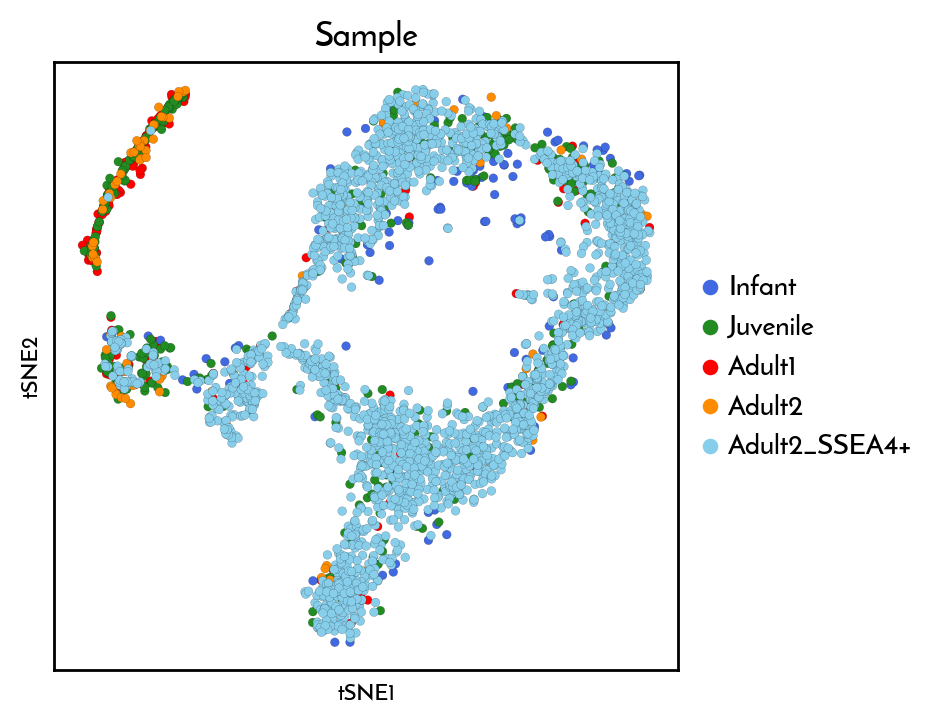

In [114]:
sc.pl.tsne(mf_sce_germSPG, color=[ "Sample"], palette=["royalblue", "forestgreen", "red", "darkorange", "skyblue"],
           size=40, edgecolor="black", linewidths=0.05, ncols=1, legend_fontsize=10, cmap="viridis", legend_fontoutline=1)

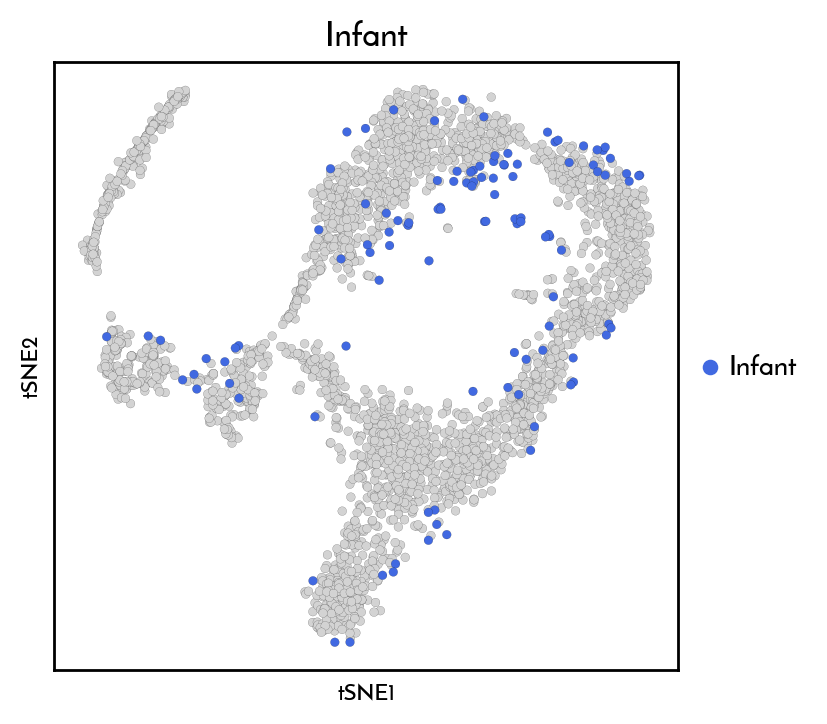

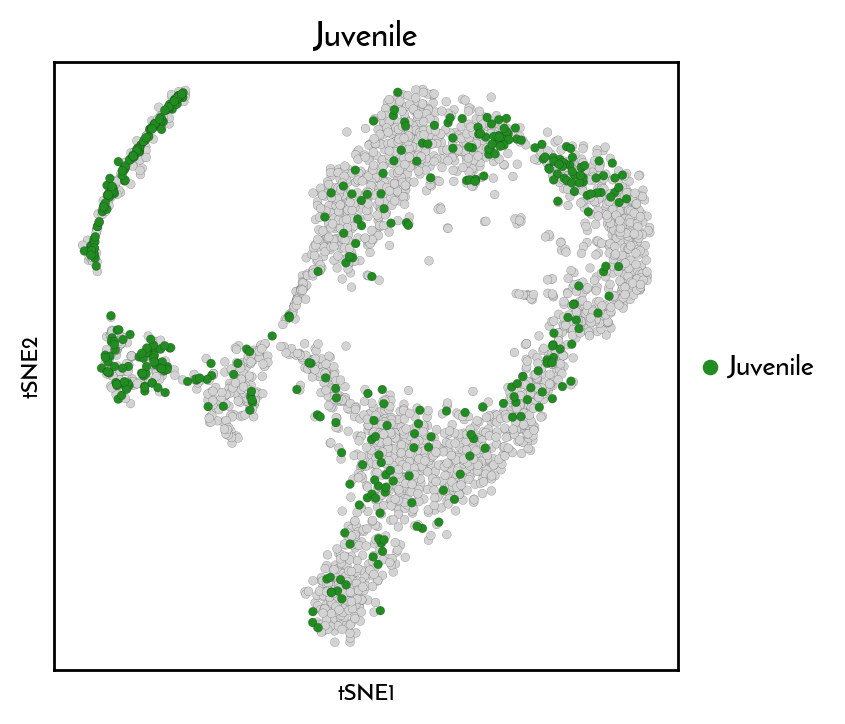

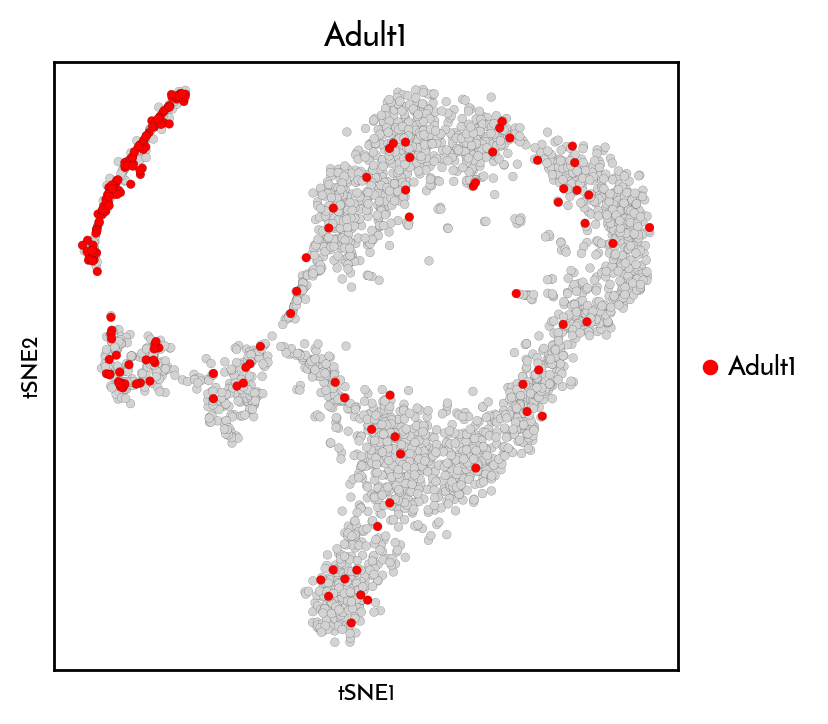

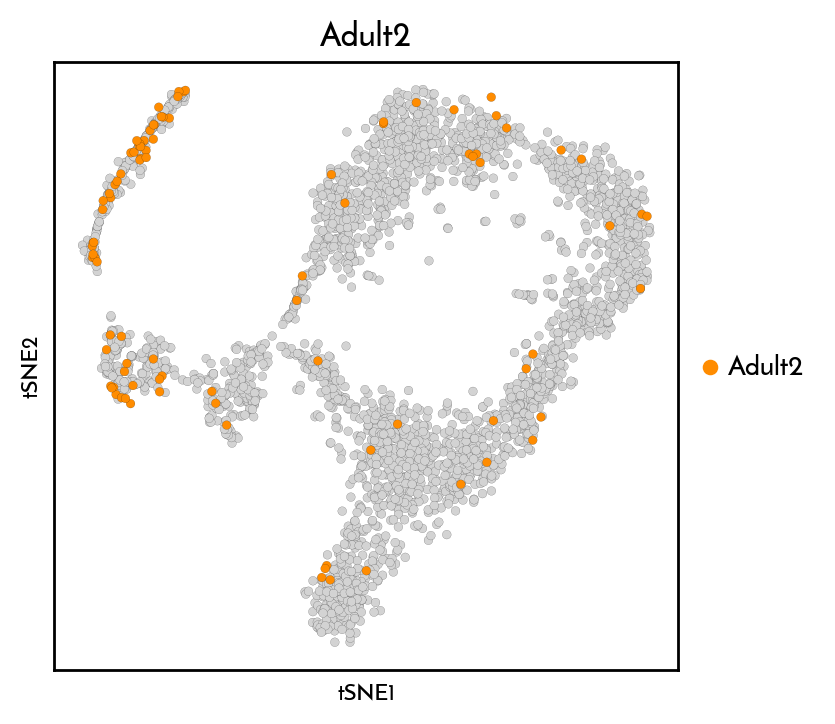

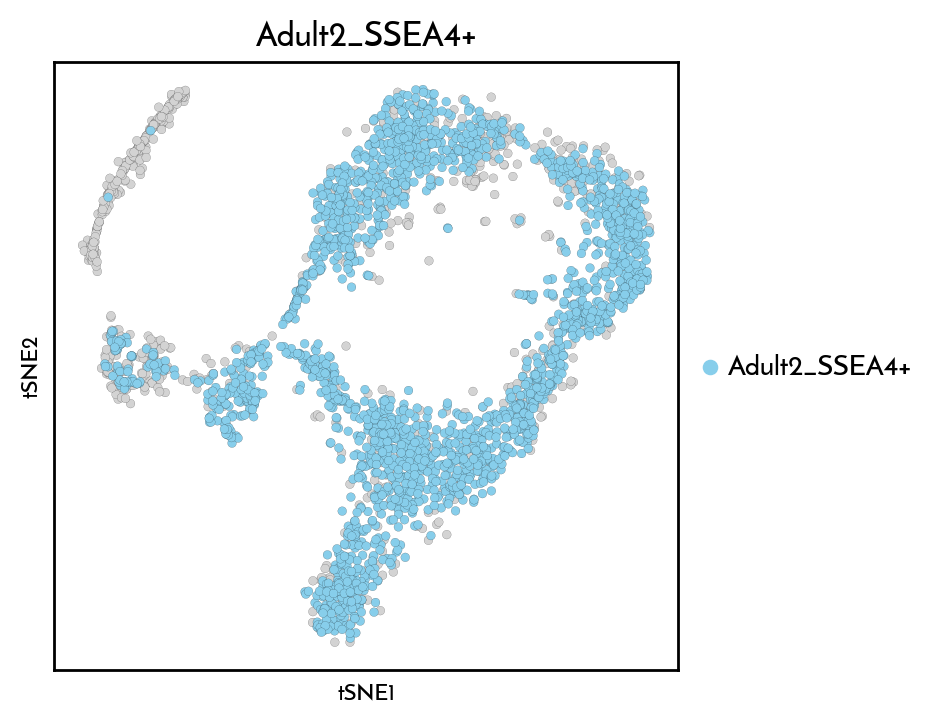

In [115]:
for s in ["Infant", "Juvenile", "Adult1", "Adult2", "Adult2_SSEA4+"]:
    sc.pl.tsne(mf_sce_germSPG, color=[ "Sample"], palette=["royalblue", "forestgreen", "red", "darkorange", "skyblue"], groups=s,
           size=40, edgecolor="black", linewidths=0.05, ncols=1, legend_fontsize=10, cmap="viridis", legend_fontoutline=1,  title=s)

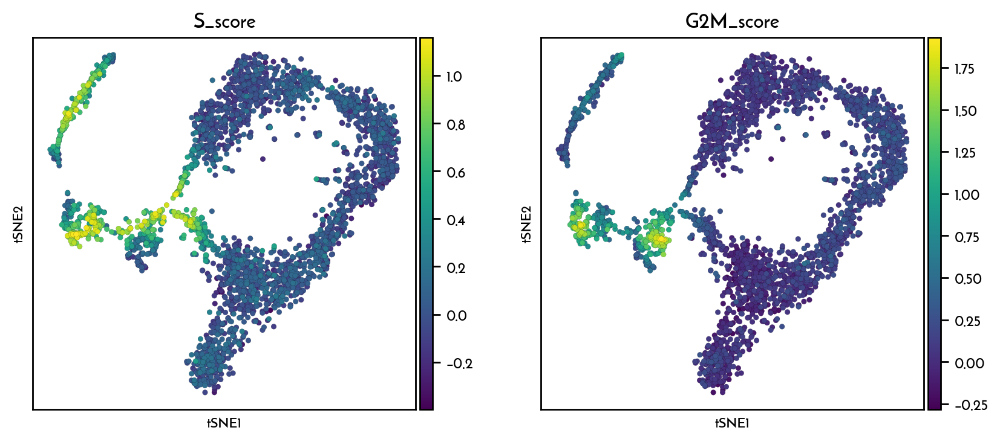

In [116]:
sc.pl.tsne(mf_sce_germSPG, color=[ "S_score", "G2M_score"], 
           size=40, edgecolor="black", linewidths=0.05, ncols=2, legend_fontsize=10, cmap="viridis", legend_fontoutline=1)

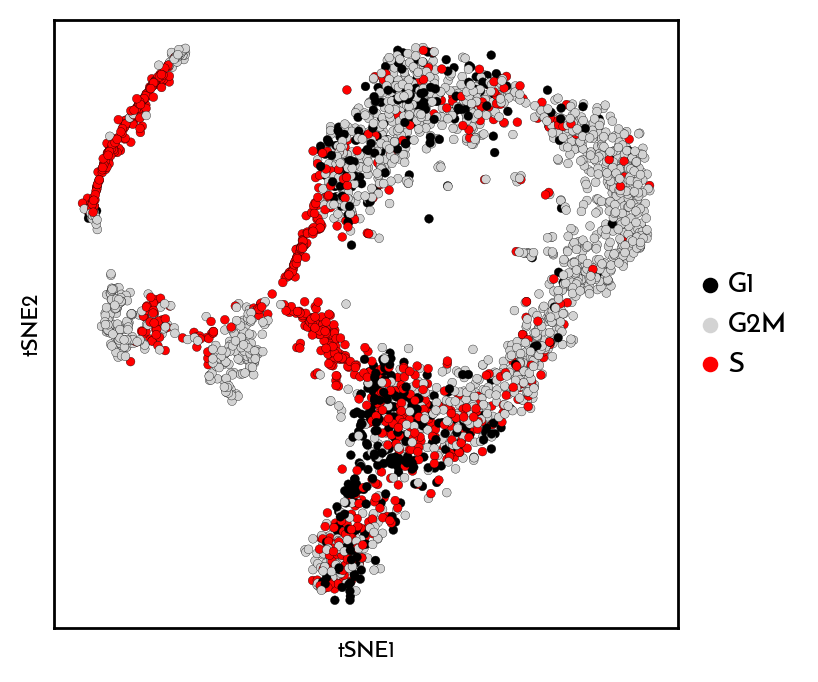

In [117]:
sc.pl.tsne(mf_sce_germSPG, color=["phase"], palette=["black", "lightgray", "red"],
           size=40, edgecolor="black", linewidths=0.125, ncols=2, legend_fontsize=10, cmap=heatcolors, legend_fontoutline=1, title="")

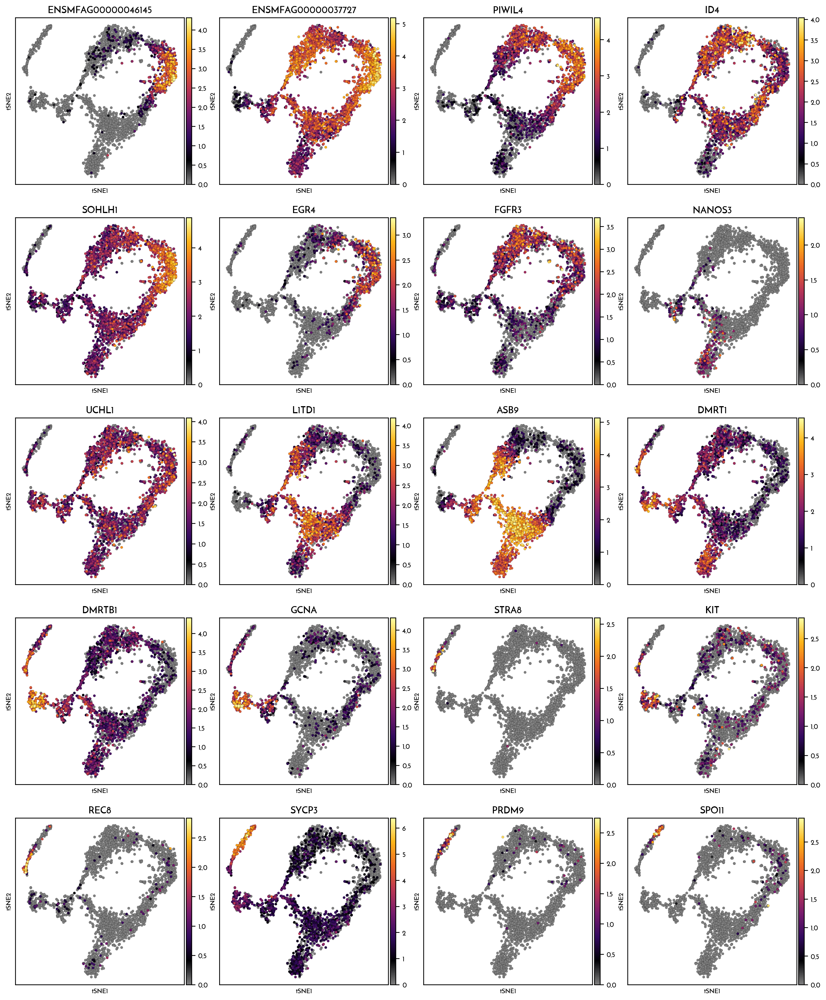

In [118]:
sc.pl.tsne(mf_sce_germSPG, color=["ENSMFAG00000046145",  "ENSMFAG00000037727", "PIWIL4", "ID4", "SOHLH1", "EGR4", "FGFR3", "NANOS3",
                                  "UCHL1", "L1TD1", "ASB9", "DMRT1","DMRTB1", "GCNA", "STRA8","KIT","REC8","SYCP3", "PRDM9", "SPO11"],
          legend_loc="on data", legend_fontsize=6, size=40, edgecolor="black", linewidths=0.1,wspace=0.1, hspace=0.2, cmap=heatcolors,
           ncols=4, layer="logcounts")

In [119]:
sc.pp.neighbors(mf_sce_germSPG, n_neighbors = 10)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [120]:
sc.tl.leiden(mf_sce_germSPG, resolution = 0.5) # Perform clustering

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


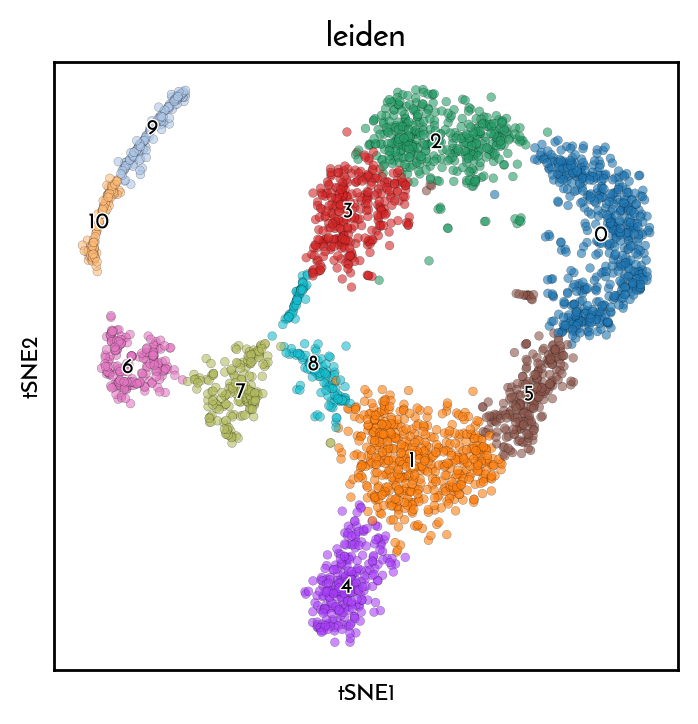

In [121]:
sc.pl.tsne(mf_sce_germSPG, color=["leiden"],legend_loc="on data", size=40, edgecolor="black", linewidths=0.1, ncols=3, legend_fontsize=8, alpha=0.6, legend_fontoutline=1)

In [122]:
spg_conditions = [
    (mf_sce_germSPG.obs["leiden"].isin(["0"])),#Undiff1
    (mf_sce_germSPG.obs["leiden"].isin(["2"])),#Undiff2
    (mf_sce_germSPG.obs["leiden"].isin(["5"])),#Undiff3
    (mf_sce_germSPG.obs["leiden"].isin(["3"])),#Ediff1
    (mf_sce_germSPG.obs["leiden"].isin(["1"])),#Ediff2
    (mf_sce_germSPG.obs["leiden"].isin(["4"])),#Ediff3
    (mf_sce_germSPG.obs["leiden"].isin(["8"])),#Ediff4
    (mf_sce_germSPG.obs["leiden"].isin(["7"])),#Mid diff
    (mf_sce_germSPG.obs["leiden"].isin(["6"])),#Late diff
    (mf_sce_germSPG.obs["leiden"].isin(["10"])),#pre-Lep
    (mf_sce_germSPG.obs["leiden"].isin(["9"]))]#Lep
spg_groups = ["Undiff1", "Undiff2", "Undiff3", "E-diff1", "E-diff2", "E-diff3", "E-diff4", "Mid diff", "Late diff", "pre-Lep",  "Lep"]

In [123]:
spg_clusters = np.select(spg_conditions, spg_groups, default="Germ")

In [124]:
mf_sce_germSPG.obs["Annotated"] = spg_clusters

In [125]:
mf_sce_germSPG.obs["Annotated"] = mf_sce_germSPG.obs["Annotated"].astype("category").cat.reorder_categories(["Undiff1", "Undiff2","Undiff3",
                                                                                                             "E-diff1", "E-diff2", "E-diff3", "E-diff4",
                                                                                                             "Mid diff", "Late diff", "pre-Lep",  "Lep"],ordered=True)

In [126]:
spg_colors = ["#FFF5EB", "#FEE6CE", "#FDD0A2", "#FDAE6B", "#FD8D3C", "#F16913",
              "#D94801", "#A63603", "#7F2704","#E4EDE4", "#BED1C2"]

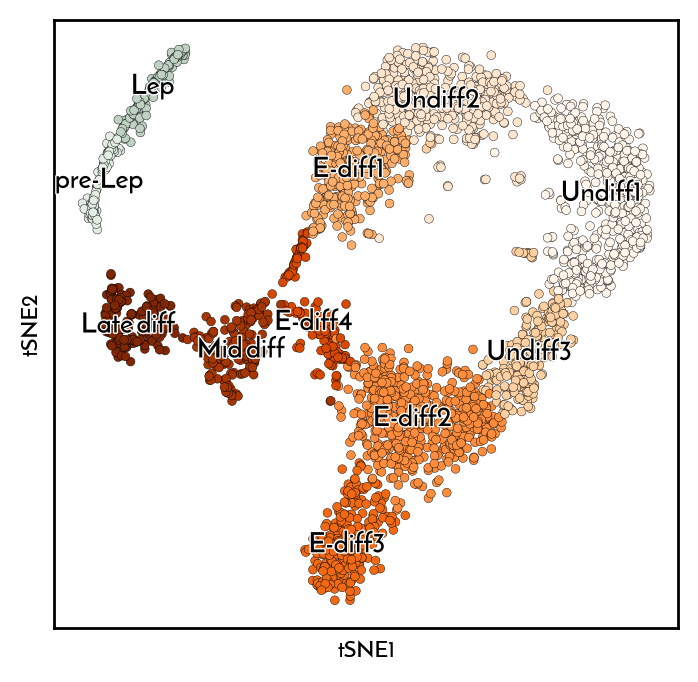

In [127]:
sc.pl.tsne(mf_sce_germSPG, color=["Annotated"],palette=spg_colors,size=40,  edgecolor="black",legend_loc="on data", legend_fontoutline=1,
           linewidths=0.15, ncols=3, legend_fontsize=10,  title="")

In [128]:
pd.crosstab(mf_sce_germSPG.obs['Annotated'], mf_sce_germSPG.obs['phase'])

phase,G1,G2M,S
Annotated,,,
Undiff1,19,483,22
Undiff2,83,272,49
Undiff3,12,185,41
E-diff1,71,175,66
E-diff2,169,169,176
E-diff3,67,112,92
E-diff4,0,2,156
Mid diff,0,158,31
Late diff,0,139,53


In [129]:
pd.crosstab(mf_sce_germSPG.obs['Annotated'], mf_sce_germSPG.obs['Sample'])

Sample,Infant,Juvenile,Adult1,Adult2,Adult2_SSEA4+
Annotated,,,,,
Undiff1,25,61,12,6,420
Undiff2,35,56,10,11,292
Undiff3,10,25,5,5,193
E-diff1,13,21,6,2,270
E-diff2,6,43,6,4,455
E-diff3,6,21,9,5,230
E-diff4,2,12,4,3,137
Mid diff,8,18,7,3,153
Late diff,4,71,28,17,72


In [130]:
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['axes.facecolor'] = 'grey'

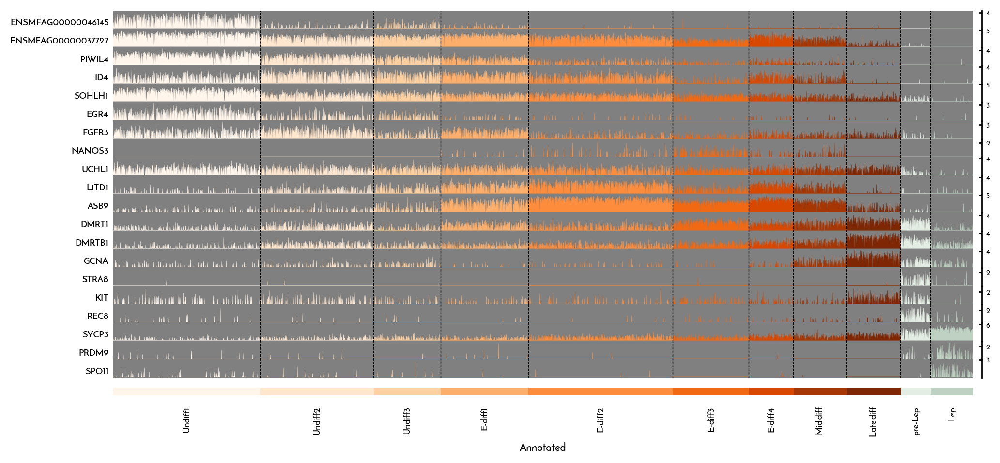

In [131]:
sc.pl.tracksplot(mf_sce_germSPG, var_names=["ENSMFAG00000046145",  "ENSMFAG00000037727", "PIWIL4", "ID4", "SOHLH1", "EGR4", "FGFR3", "NANOS3", "UCHL1", "L1TD1", "ASB9",
                                  "DMRT1","DMRTB1", "GCNA", "STRA8","KIT","REC8","SYCP3", "PRDM9", "SPO11"], groupby="Annotated", layer="logcounts");

In [132]:
plt.rcdefaults()
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf")#, vector_friendly=False)
# Set context to `"paper"`
sns.set_context("paper", font_scale=1, rc={"font.size":8,"axes.labelsize":8,"axes.titlesize":14})
plt.rcParams.update({"font.family":"Reem Kufi"})

In [133]:
sc.tl.paga(mf_sce_germSPG, groups="Annotated")

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)


--> added 'pos', the PAGA positions (adata.uns['paga'])


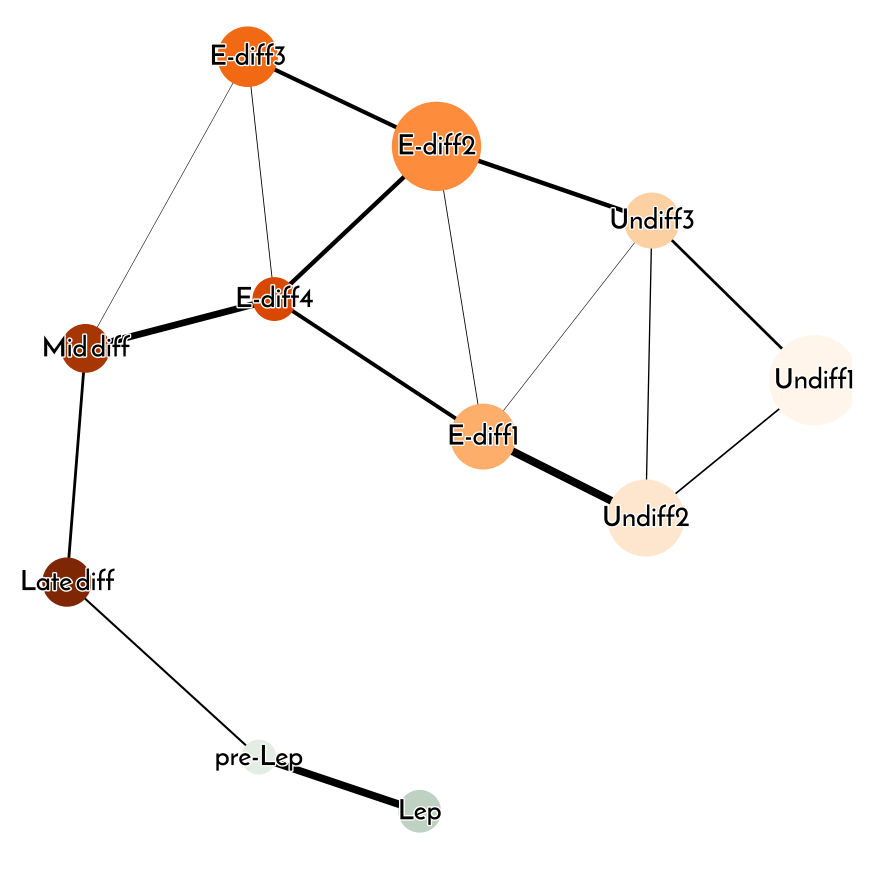

In [134]:
plt.rcParams['figure.figsize']=5,5
sc.pl.paga(mf_sce_germSPG, color="Annotated", threshold = 0.028, fontsize=10, fontoutline=1, node_size_power=1.25, node_size_scale=2.5, frameon=False)

In [135]:
sc.tl.rank_genes_groups(mf_sce_germSPG, "Annotated", n_genes=6000, method="wilcoxon", layer="logcounts", use_raw=False, rankby_abs=True)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:10)


In [136]:
spgAnnolist = {}
for i in mf_sce_germSPG.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_germSPG, group=i,pval_cutoff=0.05, log2fc_min=1.25, key="rank_genes_groups").sort_values(by="scores", ascending=False).dropna(axis=0)["names"].to_list()
    spgAnnolist[i] = genes

In [137]:
pd.DataFrame.from_dict(spgAnnolist, orient="index").transpose().head(10)

,Undiff1,Undiff2,Undiff3,E-diff1,E-diff2,E-diff3,E-diff4,Mid diff,Late diff,pre-Lep,Lep
0,MSL3,CD164,RPS4X,FTH1,APOE,BUD23,MCM6,HMGB2,TUBA3E,MEIOC,SYCP2
1,PSIP1,ZBTB20,SUPT5H,PPDPF,ASB9,CRYM,DUT,STMN1,MKI67,CALR,SYCP3
2,RNH1,ITGB1,SF3B2,FTL,L1TD1,RPS23,CENPX,TOP2A,GCNA,SDF2L1,TMEM59
3,COPRS,ATP1B1,ID1,CD164,RPS7,RPL10,ASB9,KPNA2,DMRTB1,CTCFL,HORMAD1
4,MORC1,GNAS,RPL7A,PNRC1,ENSMFAG00000002566,ENSMFAG00000043631,UNG,CALM2,TUBA3C,HSPA5,SDF2L1
5,SH2B2,BMPR1B,EEF1A1,TUBB,RPL10A,RPL10A,ENSMFAG00000040946,PTMA,CALR,PDIA6,SMC1B
6,ENSMFAG00000044835,SSR4,RPSA,SERPINE2,ENSMFAG00000030460,GMPR,MCM7,PTTG1,ESX1,CDKN2D,MEIOC
7,ENSMFAG00000046145,EPN1,DND1,GPSM3,RPS8,TSC22D3,MCM4,CENPF,ENSMFAG00000043279,SPCS3,ENSMFAG00000040566
8,PRR5,THUMPD1,ENSMFAG00000030460,C12orf57,ENSMFAG00000034356,RPS3A,MCM5,MKI67,PRC1,N4BP2,ZCWPW1
9,PIWIL4,SERPINE2,USP11,TDRD1,QARS,ENSMFAG00000002566,ENSMFAG00000034356,TUBA3C,HMGB2,ENSMFAG00000042197,LY6K


In [138]:
SPG_L1 = []
for i in mf_sce_germSPG.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_germSPG, group=i,pval_cutoff=0.01, log2fc_min=1.25, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    SPG_L1.extend(genes) 
len(SPG_L1)

5612

In [139]:
SPG_unique_genes = list(unique_everseen(SPG_L1))
len(SPG_unique_genes)

4117

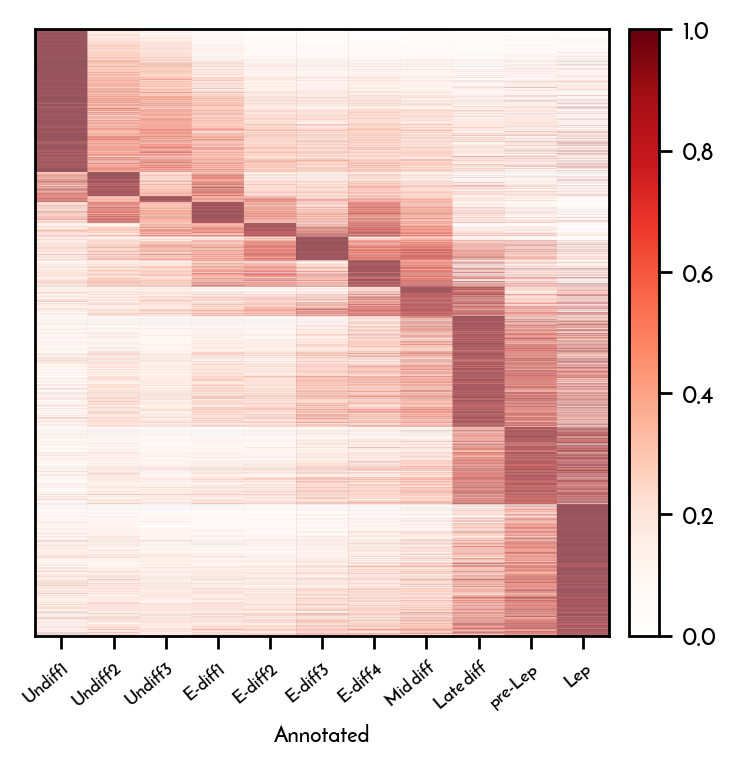

In [140]:
mat_spg = sc.pl.matrixplot(mf_sce_germSPG, SPG_L1, groupby="Annotated", figsize=(4,4),standard_scale="var", linewidth=.0001,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=False)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_Annotated']`


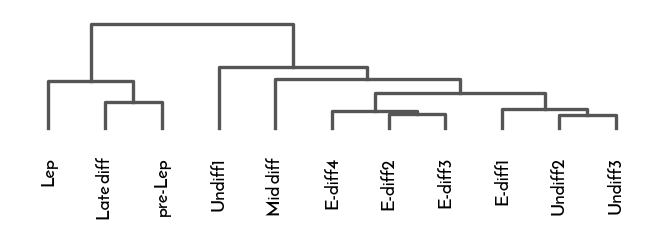

In [141]:
plt.rcParams['figure.figsize']=4,0.75
sc.pl.dendrogram(mf_sce_germSPG, groupby="Annotated");

## *RNA velocity analysis of Macaque spermatogonial cells*

In [142]:
import scvelo as scv
print(scv.__version__)

0.1.25.dev63+gbe0e5ef.d20200805


In [143]:
MUX8555_loom = scv.read("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas1_count/velocyto/MacFas1_count.loom", cache=True);
MUX8555_loom.var_names_make_unique()
MUX8990_loom = scv.read("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas2_count/velocyto/MacFas2_count.loom", cache=True);
MUX8990_loom.var_names_make_unique()
MUX8991_loom = scv.read("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas3_count/velocyto/MacFas3_count.loom", cache=True);
MUX8991_loom.var_names_make_unique()
MUX9780_loom = scv.read("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas4_count/velocyto/MacFas4_count.loom", cache=True);
MUX9780_loom.var_names_make_unique()
SSEA4_loom = scv.read("/home/projects/11001611/working/mahesh/RNA_SEQ_WORKFOLDER/Macaque_Spermatogenesis/MacFas4_SSEA4_count/velocyto/MacFas4_SSEA4_count.loom", cache=True);
SSEA4_loom.var_names_make_unique()

... reading from cache file cache/home-projects-11001611-working-mahesh-RNA_SEQ_WORKFOLDER-Macaque_Spermatogenesis-MacFas1_count-velocyto-MacFas1_count.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file cache/home-projects-11001611-working-mahesh-RNA_SEQ_WORKFOLDER-Macaque_Spermatogenesis-MacFas2_count-velocyto-MacFas2_count.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file cache/home-projects-11001611-working-mahesh-RNA_SEQ_WORKFOLDER-Macaque_Spermatogenesis-MacFas3_count-velocyto-MacFas3_count.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file cache/home-projects-11001611-working-mahesh-RNA_SEQ_WORKFOLDER-Macaque_Spermatogenesis-MacFas4_count-velocyto-MacFas4_count.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


... reading from cache file cache/home-projects-11001611-working-mahesh-RNA_SEQ_WORKFOLDER-Macaque_Spermatogenesis-MacFas4_SSEA4_count-velocyto-MacFas4_SSEA4_count.h5ad


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [144]:
mf_velodata = MUX8555_loom.concatenate(MUX8990_loom, MUX8991_loom, MUX9780_loom, SSEA4_loom)

In [145]:
# Rename the cell ids
batchid=[b.split(":")[1][16:] for b in mf_velodata.obs_names]

In [146]:
batch=np.array(batchid)
batch[np.isin(batchid,"x-0")]="-0"
batch[np.isin(batchid,"x-1")]="-1"
batch[np.isin(batchid,"x-2")]="-2"
batch[np.isin(batchid,"x-3")]="-3"
batch[np.isin(batchid,"x-4")]="-4"

In [147]:
cellid=[c.split(":")[1][:16] for c in mf_velodata.obs_names]
new_cellid=[s + "-1"+t for s,t in zip(cellid,batch)]

In [148]:
mf_velodata.obs_names=new_cellid

In [149]:
## Estimate RNA velocity for the Spermatogonia population

In [150]:
SPG=[s for s in mf_sce_germSPG.obs_names if s in mf_velodata.obs_names]

In [151]:
germSPG_velodata=mf_velodata[SPG].copy()

In [152]:
germSPG_velodata

AnnData object with n_obs × n_vars = 3060 × 21892 
    obs: 'Clusters', '_X', '_Y', 'batch'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [153]:
germSPG_velodata.obsm["X_tsne"] = mf_sce_germSPG.obsm["X_tsne"]
germSPG_velodata.obs["Annotated"] = mf_sce_germSPG.obs["Annotated"]
germSPG_velodata.uns["Annotated_colors"] = mf_sce_germSPG.uns["Annotated_colors"]

In [154]:
scv.pp.filter_and_normalize(germSPG_velodata, min_shared_counts=20, n_top_genes=4000)
scv.pp.moments(germSPG_velodata, n_pcs=30, n_neighbors=30)

Filtered out 10874 genes that are detected in less than 20 counts (shared).
Normalized count data: X, spliced, unspliced.
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:01)
Logarithmized X.
computing PCA
    with n_comps=30
    finished (0:00:05)
computing neighbors
    finished (0:00:03) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)


In [155]:
scv.tl.velocity(germSPG_velodata,mode="stochastic", vkey="stochastic_velocity")
scv.tl.velocity_graph(germSPG_velodata, vkey="stochastic_velocity")
scv.tl.velocity_embedding(germSPG_velodata, basis="tsne", vkey="stochastic_velocity")

computing velocities
    finished (0:00:03) --> added 
    'stochastic_velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:30) --> added 
    'stochastic_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'stochastic_velocity_tsne', embedded velocity vectors (adata.obsm)


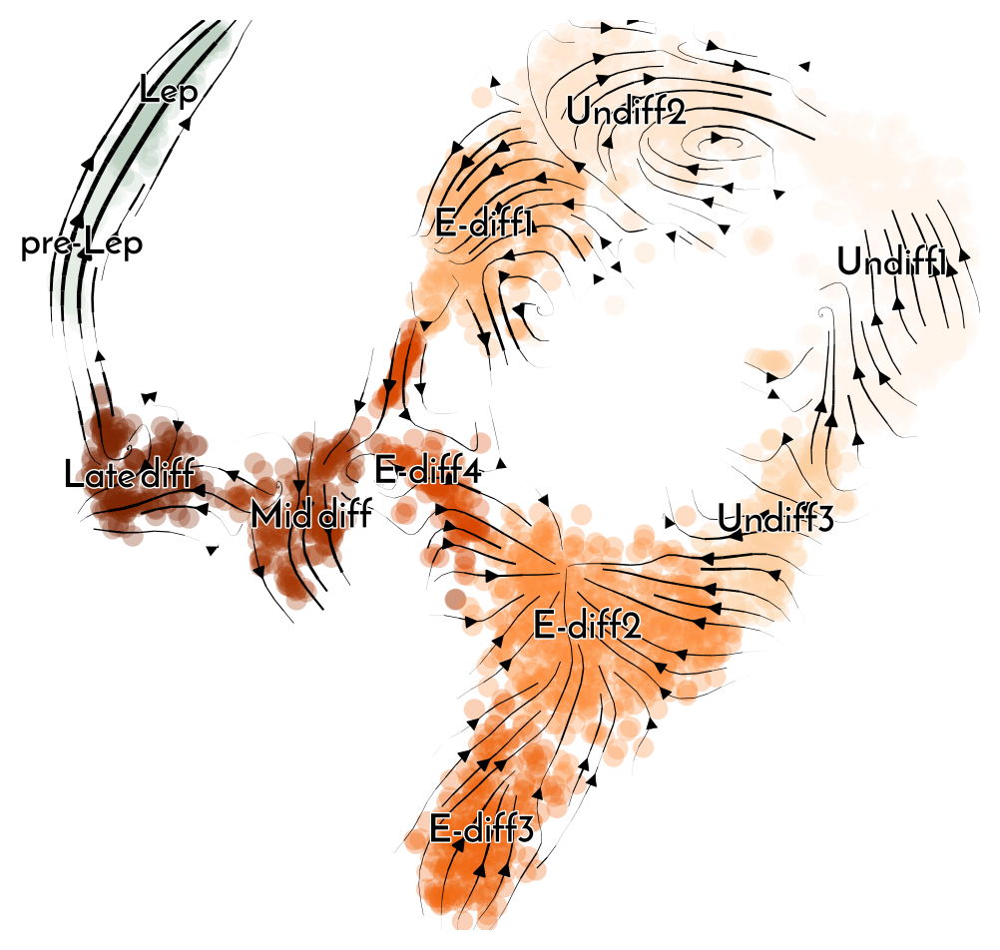

In [156]:
scv.settings.set_figure_params(figsize=(6,6), dpi=100)
scv.pl.velocity_embedding_stream(germSPG_velodata, basis="tsne", color=["Annotated"], 
                                 vkey="stochastic_velocity", title="",min_mass=0,
                                 legend_fontsize=14)

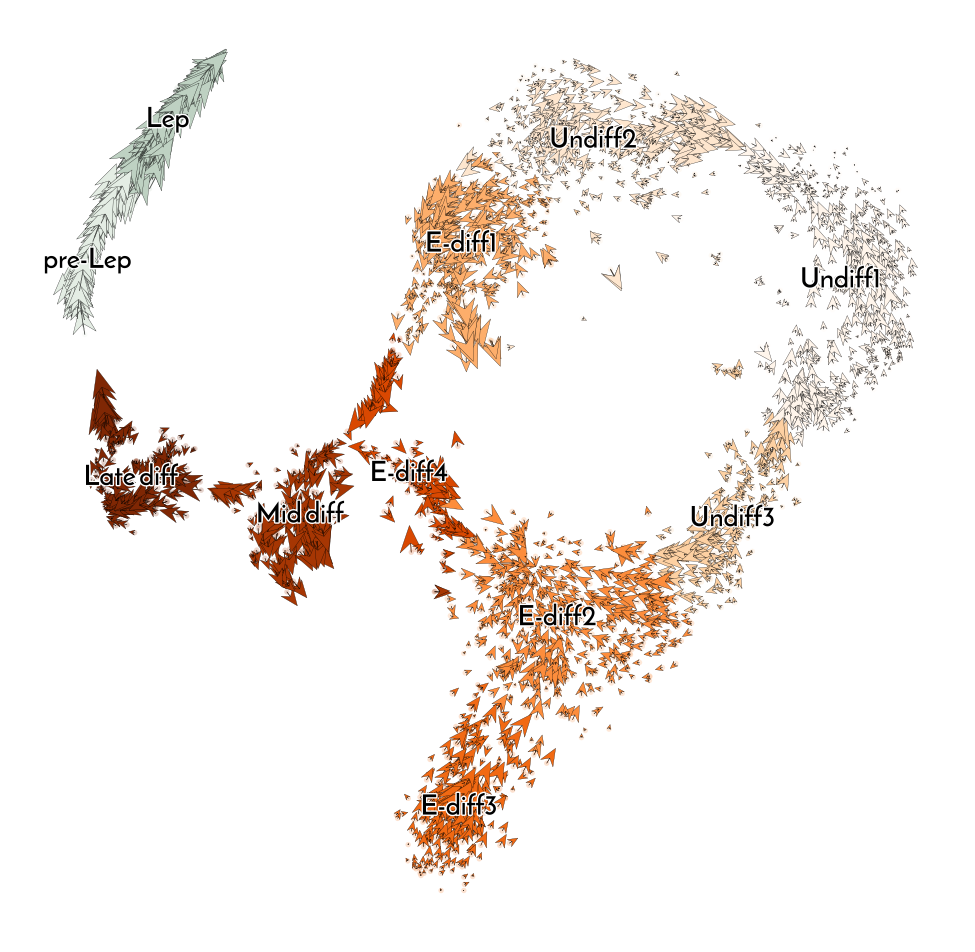

In [157]:
scv.pl.velocity_embedding(germSPG_velodata, basis="tsne", arrow_length=5, arrow_size=5, dpi=100, color="Annotated",
                          vkey="stochastic_velocity", title="",legend_loc="on data", legend_fontsize=10)

In [158]:
scv.tl.recover_dynamics(germSPG_velodata)

recovering dynamics
    finished (0:29:20) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [160]:
scv.tl.latent_time(germSPG_velodata)

computing velocities
    finished (0:00:03) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing PCA
    with n_comps=30
    finished (0:00:00)
computing velocity graph
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing terminal states
    identified 1 region of root cells and 3 regions of end points 
    finished (0:00:02) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time
    finished (0:00:06) --> added 
    'latent_time', shared time (adata.obs)


In [161]:
mf_sce_germSPG.obs["latent_time"] = germSPG_velodata.obs["latent_time"]
mf_sce_germSPG.obs["velocity_pseudotime"] = germSPG_velodata.obs["velocity_pseudotime"]
mf_sce_germSPG.uns["velocity_graph"] = germSPG_velodata.uns["stochastic_velocity_graph"]

In [163]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf")
# Set context to `"paper"`
sns.set_context("paper", font_scale=1, rc={"font.size":8,"axes.labelsize":8,"axes.titlesize":14})

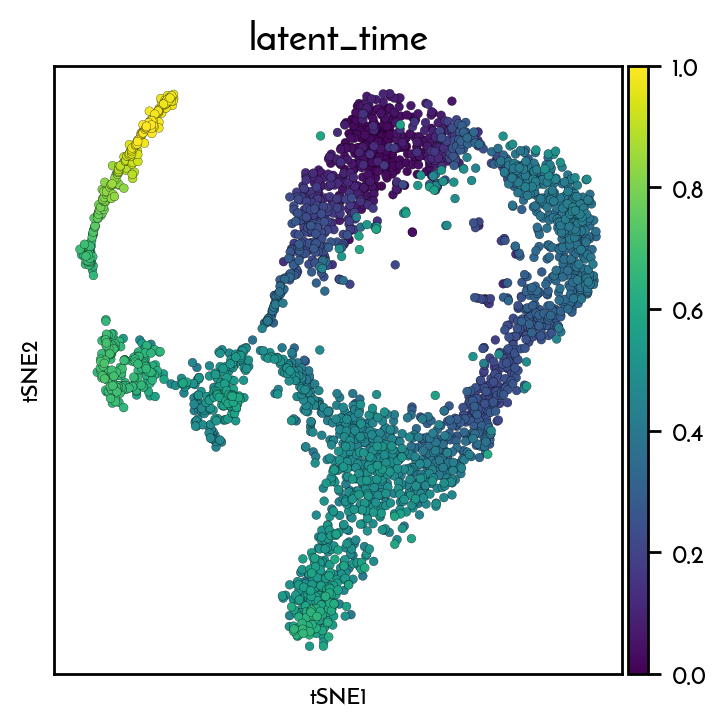

In [164]:
sc.pl.tsne(mf_sce_germSPG, color=["latent_time"], legend_loc="on data", ncols=1, legend_fontsize=6, size=40, edgecolor="black",
           cmap="viridis", linewidths=0.1)

## *Analysis of macaque germ cells (Spermatogonia to Sperm)*

In [165]:
%%R -o mf_sce_germ
## GERM
mf_sce_germ <- mf_sce[,mf_sce$broadcluster=="Germ"]
mf_sce_germ <- mf_sce_germ[Matrix::rowSums(counts(mf_sce_germ)) > 0, ]
mf_sce_germ$mf_leiden_clusters <- factor(mf_sce_germ$mf_leiden_clusters)

# Identify HVGs based on sample
set.seed(55063)
mod_mf_batch_germ <- modelGeneVar(mf_sce_germ, block=colData(mf_sce_germ)$Sample)
hvgs_mf_batch_germ <- getTopHVGs(mod_mf_batch_germ, prop=0.1)
print(paste("HVGs used:", length(hvgs_mf_batch_germ)))

set.seed(55063)
mf_sce_germ_corrected <- fastMNN(mf_sce_germ, subset.row=hvgs_mf_batch_germ, batch=mf_sce_germ$Sample)
reducedDim(mf_sce_germ, "mnn") <- reducedDim(mf_sce_germ_corrected, "corrected")
mf_sce_germ$mf_leiden_clusters <- as.character(mf_sce_germ$mf_leiden_clusters)

[1] "HVGs used: 1017"


Transforming to str index.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [166]:
mf_sce_germ.var_names_make_unique()

In [167]:
mf_sce_germ.obs['Library'] = mf_sce_germ.obs['Sample']

mf_sce_germ.obs['batch'] = mf_sce_germ.obs['Library'].replace({
    "MUX8555":"-0",
    "MUX8990": "-1",
    "MUX8991": "-2",
    "MUX9780": "-3",
    "SSEA4": "-4"
})

mf_sce_germ.obs['Sample'] = mf_sce_germ.obs['Library'].replace({
    "MUX8555":"Adult1",
    "MUX8990": "Infant",
    "MUX8991": "Juvenile",
    "MUX9780": "Adult2",
    "SSEA4": "Adult2_SSEA4+"
})
mf_sce_germ.obs.index = mf_sce_germ.obs['Barcode']+mf_sce_germ.obs['batch']

In [168]:
mf_sce_germ.obs['Sample'].value_counts()

Adult1           5423
Adult2           3282
Juvenile         2977
Adult2_SSEA4+    2496
Infant            109
Name: Sample, dtype: int64

In [169]:
mf_sce_germ.obs['sum'].describe() # UMI summary statistics

count    14287.000000
mean     25388.085042
std      18973.661650
min       3501.000000
25%      12356.000000
50%      20588.000000
75%      30015.000000
max      99926.000000
Name: sum, dtype: float64

In [170]:
mf_sce_germ.obs['detected'].describe() # genes detected - summary statistics

count    14287.000000
mean      3850.699447
std       1304.424667
min        655.000000
25%       2972.000000
50%       4043.000000
75%       4687.500000
max       8601.000000
Name: detected, dtype: float64

In [171]:
mf_sce_germ.obs['Annotated'] = mf_sce_germ.obs['mf_leiden_clusters']

mf_sce_germ.obs['Annotated'] = mf_sce_germ.obs['Annotated'].astype(str)

for idx, x in mf_sce_germSPG.obs['Annotated'].iteritems():
    mf_sce_germ.obs.at[idx, 'Annotated'] = x 

In [172]:
mf_sce_germ.obsm['X_tsne'] = mf_sce_germ.obsm['mnnTSNE']

In [173]:
mf_sce_germ.obsm['X_pca'] = mf_sce_germ.obsm['mnn']

... storing 'Sample' as categorical
... storing 'Barcode' as categorical
... storing 'mf_leiden_clusters' as categorical
... storing 'broadcluster' as categorical
... storing 'Library' as categorical
... storing 'batch' as categorical
... storing 'Annotated' as categorical
... storing 'Symbol' as categorical
... storing 'Type' as categorical


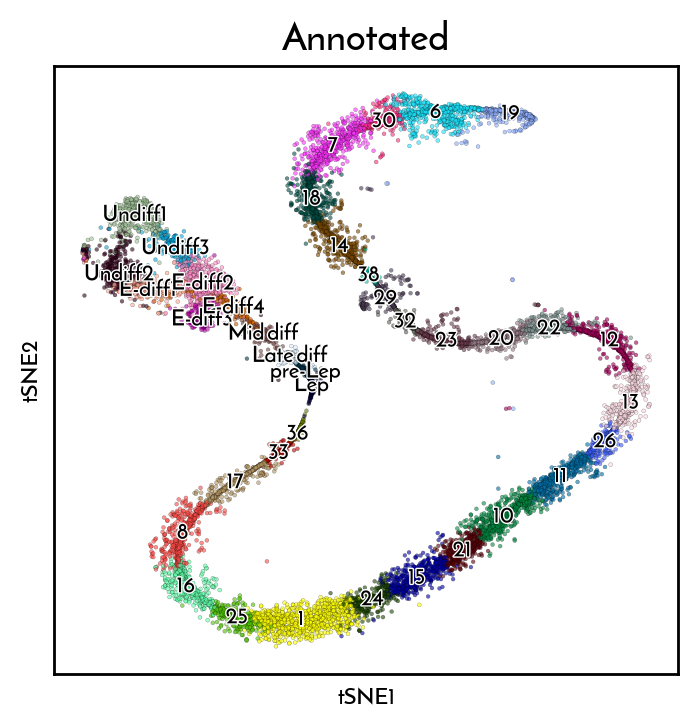

In [174]:
sc.pl.tsne(mf_sce_germ, color=["Annotated"], size=8, legend_loc="on data", edgecolor="black",
           linewidths=0.1, ncols=3, legend_fontsize=8, alpha=0.6, legend_fontoutline=1)

In [175]:
mf_sce_germ.obs["Annotated"] = mf_sce_germ.obs["Annotated"].replace({
    "36":"Lep",
    "33": "Zyg",
    "17": "Pach1",
    "8": "Pach2",
    "16": "Pach3",
    "25": "Pach4",
    "1": "Pach5",
    "24": "Pach6",
    "15": "Pach7",
    "21": "Pach8",
    "10": "Pach9",
    "11": "Pach10",
    "26": "Dip & Sec. Spcs",
    "13": "RS1",
    "12": "RS2",
    "22": "RS3",
    "20": "RS4",
    "23": "RS5",
    "32": "RS6",
    "29": "RS7",
    "38": "ES1",
    "14": "ES2",
    "18": "ES3",
    "7": "ES4",
    "30": "ES5",
    "6": "ES6",
    "19": "Imm. Sperm"
})

In [176]:
mf_sce_germ.obs["Annotated"] = mf_sce_germ.obs["Annotated"].astype("category").cat.reorder_categories(["Undiff1", "Undiff2", "Undiff3",
                                                                                                       "E-diff1", "E-diff2","E-diff3", "E-diff4", "Mid diff", "Late diff",
                                                                                                       "pre-Lep",  "Lep", "Zyg",
                                                                                                       "Pach1","Pach2","Pach3","Pach4","Pach5","Pach6","Pach7","Pach8","Pach9", "Pach10", "Dip & Sec. Spcs",
                                                                                                       "RS1","RS2","RS3","RS4","RS5","RS6","RS7",
                                                                                                       "ES1","ES2","ES3","ES4","ES5","ES6","Imm. Sperm"],ordered=True)

In [177]:
bc_cols = ["#FFF5EB", "#FEE6CE", "#FDD0A2", "#FDAE6B", "#FD8D3C", "#F16913", "#D94801", "#A63603", "#7F2704",
          "#F7FCF5", "#E4EDE4", "#D1DFD3", "#BED1C2", "#ABC3B1", "#98B5A1", "#84A790", "#71987F", "#5F8A6E", "#4C7C5E", "#386E4D", "#25603C", "#12522B", "#00441B",
          "#EFF3FF", "#C6DBEF", "#9ECAE1", "#6BAED6", "#4292C6", "#2171B5", "#084594",
           "#f3cbd3", "#eaa9bd", "#dd88ac", "#ca699d", "#b14d8e", "#91357d", "#6c2167"]

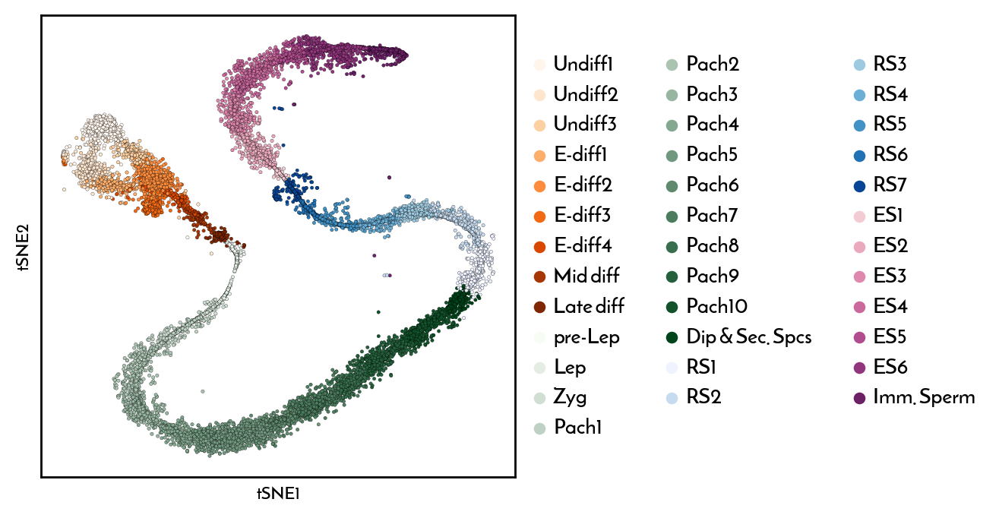

In [178]:
sc.pl.tsne(mf_sce_germ, color=["Annotated"], size=10, palette=bc_cols,
            edgecolor="black", linewidths=0.1, ncols=4, legend_fontsize=10, title="")

In [179]:
## Integrate all annotations on the whole data
mf_sce_gs.obs['Annotated'] = mf_sce_gs.obs['broad_clusters']
mf_sce_gs.obs['Annotated'] = mf_sce_gs.obs['Annotated'].astype('str')

In [180]:
for idx, x in mf_sce_germ.obs['Annotated'].iteritems():
    mf_sce_gs.obs.at[idx, 'Annotated'] = x 

In [181]:
mf_sce_germ.obs['broad_germ'] = None
for idx, x in mf_sce_gs.obs['broad_clusters'][mf_sce_gs.obs['broadcluster'].isin(['Germ'])].iteritems():
    mf_sce_germ.obs.at[idx, 'broad_germ'] = x 

In [182]:
mf_sce_germ.obs['broad_germ'] = mf_sce_germ.obs['broad_germ'].astype("category").cat.reorder_categories(["Spermatogonia", "Spermatocytes",  "Round spermatids", "Elongating spermatids","Immature Sperm"], ordered=True)

In [183]:
mf_sce_gs.obs["Annotated"] = mf_sce_gs.obs["Annotated"].astype("category").cat.reorder_categories(["Myoid","Immature Leydig", "Leydig", "Sertoli", "Macrophage", "Endothelial", "Undiff1", "Undiff2", "Undiff3",
                                                                                                       "E-diff1", "E-diff2","E-diff3","E-diff4", "Mid diff", "Late diff",
                                                                                                       "pre-Lep",  "Lep", "Zyg",
                                                                                                       "Pach1","Pach2","Pach3","Pach4","Pach5","Pach6","Pach7","Pach8","Pach9", "Pach10", "Dip & Sec. Spcs",
                                                                                                       "RS1","RS2","RS3","RS4","RS5","RS6","RS7",
                                                                                                       "ES1","ES2","ES3","ES4","ES5","ES6","Imm. Sperm"],ordered=True)

In [184]:
palette = ["#FFB292","gold", "lightslategray", "#936C00","lime", "red",
           "#FFF5EB", "#FEE6CE", "#FDD0A2", "#FDAE6B", "#FD8D3C", "#F16913", "#D94801", "#A63603", "#7F2704",
          "#F7FCF5", "#E4EDE4", "#D1DFD3", "#BED1C2", "#ABC3B1", "#98B5A1", "#84A790", "#71987F", "#5F8A6E", "#4C7C5E", "#386E4D", "#25603C", "#12522B", "#00441B",
          "#EFF3FF", "#C6DBEF", "#9ECAE1", "#6BAED6", "#4292C6", "#2171B5", "#084594",
           "#f3cbd3", "#eaa9bd", "#dd88ac", "#ca699d", "#b14d8e", "#91357d", "#6c2167"]

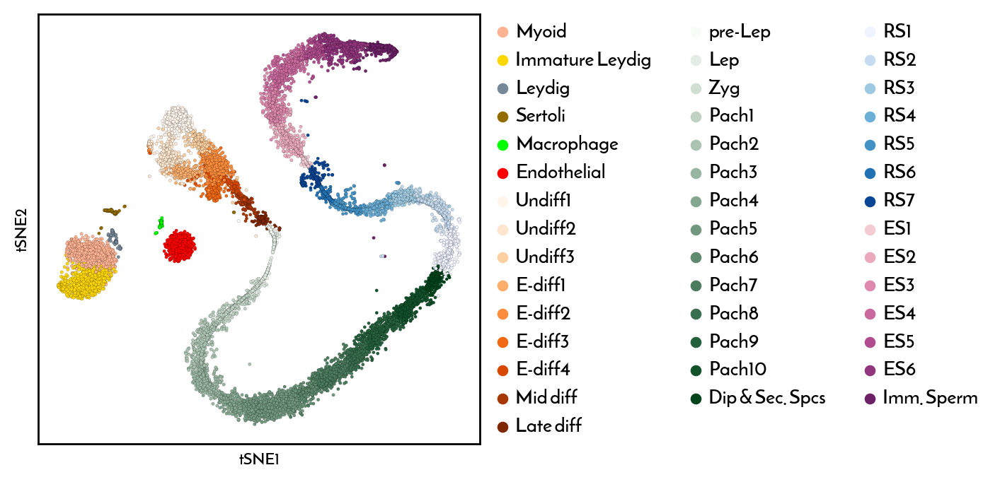

In [185]:
sc.pl.tsne(mf_sce_gs, color=["Annotated"], size=10, palette=palette,
            edgecolor="black", linewidths=0.05, legend_fontsize=10, title="")

In [186]:
sc.tl.rank_genes_groups(mf_sce_germ, "Annotated", n_genes = 6000, method = "wilcoxon", layer = "logcounts", use_raw = False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:37)


In [187]:
germlist = {}
for i in mf_sce_germ.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_germ, group=i,pval_cutoff=0.01, log2fc_min=1.25, 
                                        key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    germlist[i] = genes

In [188]:
for key, value in germlist.items():
    #print value
    print(key, len([item for item in value if item]))

Undiff1 2918
Undiff2 2574
Undiff3 2012
E-diff1 2734
E-diff2 2400
E-diff3 2406
E-diff4 2436
Mid diff 2458
Late diff 2237
pre-Lep 1329
Lep 1549
Zyg 2029
Pach1 2398
Pach2 3064
Pach3 3480
Pach4 2991
Pach5 2104
Pach6 1313
Pach7 984
Pach8 912
Pach9 942
Pach10 1142
Dip & Sec. Spcs 1296
RS1 1462
RS2 1888
RS3 1877
RS4 2163
RS5 2241
RS6 2357
RS7 2085
ES1 2697
ES2 2758
ES3 2192
ES4 1695
ES5 1386
ES6 1099
Imm. Sperm 776


In [189]:
germ_L1 = []
for i in mf_sce_germ.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(mf_sce_germ, group=i,pval_cutoff=0.01, log2fc_min=1.25, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    germ_L1.extend(genes) 

In [190]:
germ_unique_genes = list(unique_everseen(germ_L1))
len(germ_unique_genes)

12607

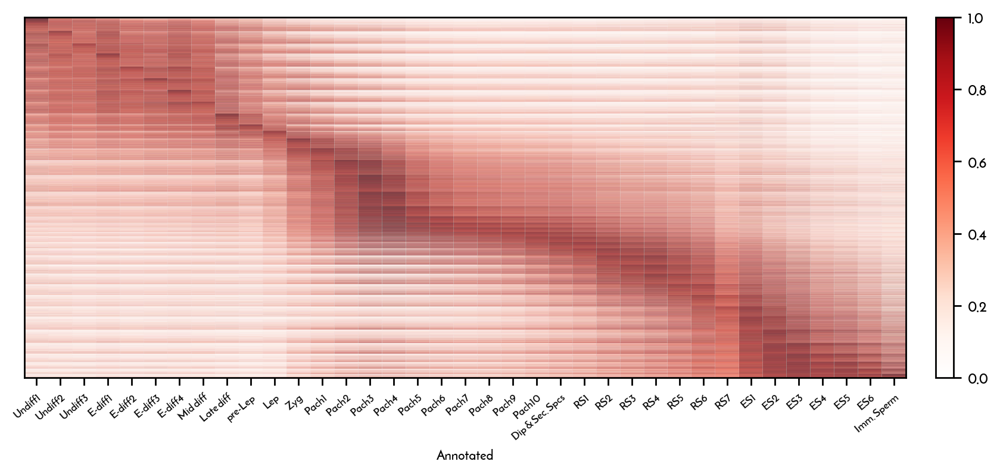

In [191]:
ax, mat_germ = sc.pl.matrixplot(mf_sce_germ, germ_L1, groupby="Annotated", figsize=(10, 4),standard_scale="var", linewidth=.00001,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts",show=False, show_gene_labels=False)

In [192]:
mf_sce_germ.obsm["X_pca"] = mf_sce_germ.obsm["mnn"]

In [193]:
sc.pp.neighbors(mf_sce_germ, n_neighbors = 5) # Find the neighbours

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)


In [194]:
sc.tl.paga(mf_sce_germ, groups="Annotated") # PAGA - Partition-based graph abstraction

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:01)


--> added 'pos', the PAGA positions (adata.uns['paga'])


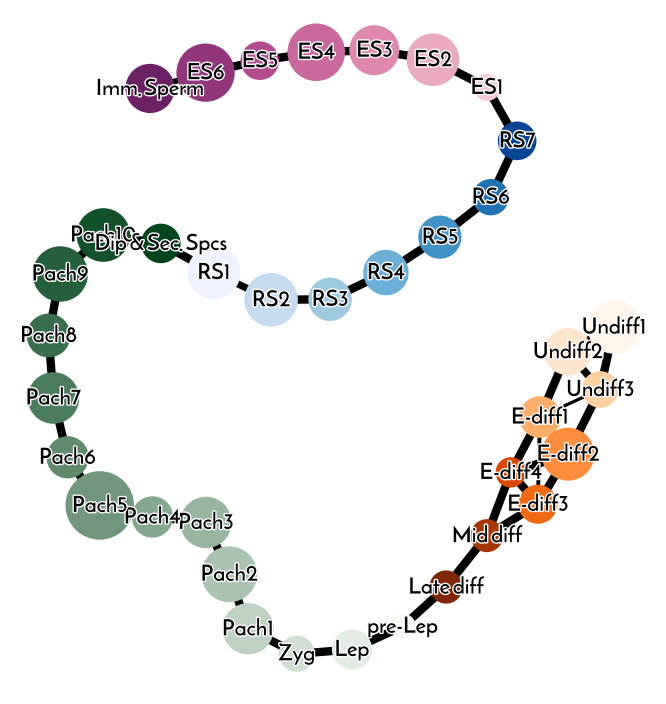

In [195]:
sc.pl.paga(mf_sce_germ, color="Annotated", threshold=0.2848, fontsize=8, node_size_scale=1.8,
           node_size_power=1, edge_width_scale=0.5, fontoutline=1, frameon=False)

In [196]:
mf_sce_germ.obs['germAD_clusters'] = mf_sce_germ.obs['Annotated']

In [197]:
mf_sce_germ.X = mf_sce_germ.layers["logcounts"]

### *MSCI related analysis in germ cells*

In [198]:
# Load gene annnotation file
allgenes = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/gene_annotation.txt", index_col=0)

In [199]:
#chr_genes = {}
for ch in allgenes['Chromosome'].astype("category").cat.categories.tolist():
    genes = allgenes["Chromosome"]==ch
    Agenes = set(allgenes[genes].index.tolist()).intersection(mf_sce_germ.var_names.tolist())
    mf_sce_germ.obs[ch] = np.ravel((mf_sce_germ[:, list(Agenes)].X != 0).sum(axis=1))

In [200]:
AllChr_df = pd.DataFrame()
for column in ['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '3', '4', '5', '6', '7', '8', '9', 'MT', 'X', 'Y']:
    x = mf_sce_germ.obs[column]
    AllChr_df[column] = x
    
AllChr_df['germAD_clusters'] = mf_sce_germ.obs['germAD_clusters']
AllChr_df_melted = AllChr_df.melt(id_vars="germAD_clusters", var_name="key", value_name="value")

In [201]:
AllChr_df_melted_mean = AllChr_df_melted.groupby(["germAD_clusters", "key"], as_index=False).mean()
#Reshape the data
AllChr_df_mean_reshaped = AllChr_df_melted_mean.pivot(index="key",columns="germAD_clusters")

In [202]:
AllChr_df_melted_std = AllChr_df_melted.groupby(["germAD_clusters", "key"]).std().reset_index()
AllChr_df_melted_std_reshaped = AllChr_df_melted_std.pivot(index="key",columns="germAD_clusters")

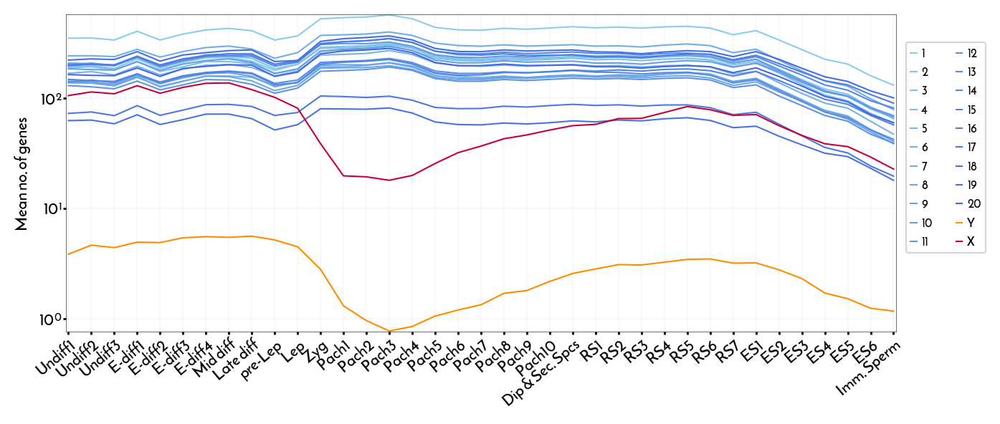

In [203]:
plt.rcParams["axes.linewidth"] = 0.2
plt.rcParams["figure.figsize"]=7,3
cols = ["#87CEEB", "#83C8EA", "#7FC3E9", "#7BBEE9", "#78B8E8", "#74B3E8", 
"#70AEE7", "#6DA8E7", "#69A3E6", "#659EE6", "#6298E5", "#5E93E5", 
"#5A8EE4", "#5788E4", "#5383E3", "#4F7EE3", "#4C78E2", "#4873E2", 
"#446EE1", "#4169E1", "darkorange"]
i=0
for c in ['1', '2','3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14',
          '15', '16', '17', '18', '19', '20', 'Y']:
    plt.plot(AllChr_df_mean_reshaped.iloc[0].index.get_level_values(1).tolist(), 
             AllChr_df_mean_reshaped.loc[c], linewidth=0.75, color=cols[i], label = c,
             alpha=1)
    i+=1

    
plt.plot(AllChr_df_mean_reshaped.iloc[0].index.get_level_values(1).tolist(), 
             AllChr_df_mean_reshaped.iloc[21], linewidth=0.75, marker='', color= "#C70039", label="X")
# Add legend
plt.legend(loc="center", ncol=2, fontsize=6, bbox_to_anchor=(1.06, 0.58))
# Add titles
#plt.title("Mean no. of genes", loc='left', fontsize=12, fontweight=2, color='black')
plt.ylabel("Mean no. of genes", fontsize=8)
plt.xlabel("")
plt.xticks(rotation=40, fontsize=8,horizontalalignment="right", rotation_mode="anchor")
plt.tick_params(axis="both",  which="minor", left=False)
plt.tick_params(axis="both",  which="major",  bottom=True, top=False,  left=True, labelbottom=True, pad=0.5, length=1.5, labelsize=8)
plt.yscale('log', basey=10)
plt.tight_layout()
plt.margins(0.003,0.003)
plt.grid(linestyle='-', linewidth='0.1')

In [204]:
# Retrive chromosomes X, Y, 9 and autosomal genes for X to A ratio
chrX_genes = allgenes["Chromosome"]=="X"
chrY_genes = allgenes["Chromosome"]=="Y"
chr9_genes = allgenes["Chromosome"]=="9"
chrA_genes = allgenes[~allgenes.Chromosome.isin(["X","Y", "MT"])]

In [205]:
# Retrieve the X and Y genes specifically present in the germ cells alone
germ_Xgenes = set(allgenes[chrX_genes].index.tolist()).intersection(mf_sce_germ.var_names.tolist())
germ_Ygenes = set(allgenes[chrY_genes].index.tolist()).intersection(mf_sce_germ.var_names.tolist())
germ_9genes = set(allgenes[chr9_genes].index.tolist()).intersection(mf_sce_germ.var_names.tolist())
germ_Agenes = set(chrA_genes["gene_short_name"].tolist()).intersection(mf_sce_germ.var_names.tolist())

In [206]:
# Calculate X to Autosome ratio, also Y to Autosome and as reference chr9 to Autosomes

In [207]:
mf_sce_germ.obs["Chr X"] = np.mean(
    mf_sce_germ[:, list(germ_Xgenes)].X, axis=1).A1 / np.mean(mf_sce_germ[:, list(germ_Agenes)].X, axis=1).A1

mf_sce_germ.obs["Chr 9"] = np.mean(
    mf_sce_germ[:, list(germ_9genes)].X, axis=1).A1 / np.mean(mf_sce_germ[:, list(germ_Agenes)].X, axis=1).A1

In [208]:
germXA_data = mf_sce_germ.obs["germAD_clusters"].to_frame().join(mf_sce_germ.obs["Chr 9"]).join(mf_sce_germ.obs["Chr X"])
#Melt the data to long format
germXA_data_melted = germXA_data.melt(id_vars="germAD_clusters", var_name="key", value_name="value")

In [209]:
## Test if the X:A ratio is significantly different between Late diff vs Zyg
from scipy import stats

stats.mannwhitneyu(germXA_data_melted[(germXA_data_melted['germAD_clusters'].isin(['Late diff'])) & (germXA_data_melted['key'].isin(['Chr X']))].value,
              germXA_data_melted[(germXA_data_melted['germAD_clusters'].isin(['Zyg'])) & (germXA_data_melted['key'].isin(['Chr X']))].value)

MannwhitneyuResult(statistic=0.0, pvalue=3.031941076756059e-70)

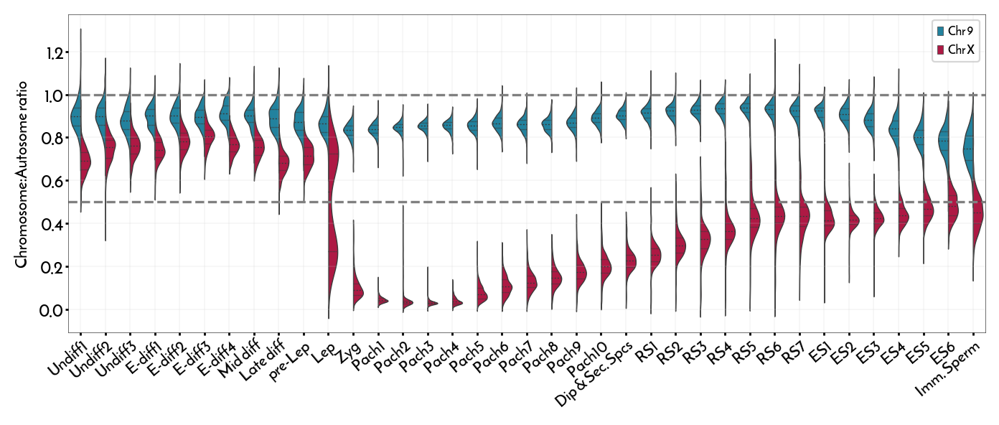

In [210]:
## Plot the mean X:A ratio of each cell as violin

from matplotlib.ticker import FormatStrFormatter

plt.rcParams["figure.figsize"]=7,3
bx = sns.violinplot(x="germAD_clusters", y="value",
            hue="key", palette=["#0D8DB3","#C70039"],fliersize=0.1,linewidth=0.5,split=True,scale="count",inner="quartile",
            data=germXA_data_melted)
bx.set(xlabel="")
bx.set_ylabel("Chromosome:Autosome ratio", fontsize=8)
bx.set_xticklabels(bx.get_xticklabels(), rotation=40, fontsize=8,horizontalalignment="right", rotation_mode="anchor", visible=True)
bx.grid(linestyle='-', linewidth='0.1')
bx.tick_params(
    axis="both",          # changes apply to the x-axis
    which="major",      # both major and minor ticks are affected
    bottom=True,      # ticks along the bottom edge are off
    top=False,  left=True, labeltop=False,      # ticks along the top edge are off
    labelbottom=True, pad=0.5, length=1.5)
bx.axhline(y=0.5,color='gray',linestyle='--')
bx.axhline(y=1,color='gray',linestyle='--')
plt.legend(loc="upper right", fontsize=6)
plt.tight_layout()

### *Pseudotime analysis*

In [211]:
sc.pp.neighbors(mf_sce_germ, n_pcs=50, knn=False, method="gauss")# Find the neighbours
sc.tl.diffmap(mf_sce_germ)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:32)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:44)
    eigenvalues of transition matrix
    [1.         0.9987826  0.9971632  0.995087   0.99128956 0.9873149
     0.98210853 0.976778   0.9695795  0.9607589  0.9546642  0.9478545
     0.94204146 0.93397963 0.92472637]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:01:02)


In [212]:
mf_sce_germ.uns["iroot"] = np.flatnonzero(mf_sce_germ.obs["germAD_clusters"]  == "Undiff1")[0] # Set the root cell
sc.tl.dpt(mf_sce_germ)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


In [214]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf")
sns.set_context("paper", font_scale=1, rc={"font.size":8,"axes.labelsize":12,"axes.titlesize":12})

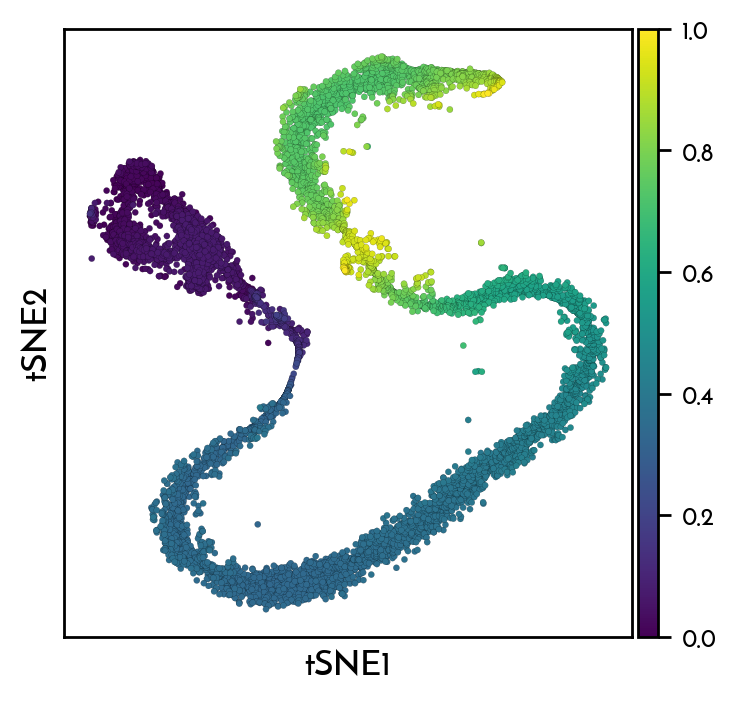

In [215]:
sc.pl.tsne(mf_sce_germ, color=["dpt_pseudotime"], legend_fontsize=10, cmap= "viridis",
           size=20, edgecolor="black", linewidths=0.05,title="") #Use gauss method to find neighbors to get proper pseudotime

## *Analysis on macaque sex chromosome genes*

In [216]:
# Load chr X gene annnotation file
Xgenes = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/28Feb/Macaque/Macaque_Xgenes_Annotated_updated.csv")

In [217]:
Xgenes.index = Xgenes['gene_short_name'].tolist()

In [218]:
germXsingle_sce = mf_sce_germ[:,mf_sce_germ.var['Symbol'][mf_sce_germ.var['Symbol'].isin(Xgenes['gene_short_name'][Xgenes['gene_class']=="SingleCopy"])].tolist()]
germXMulti_sce = mf_sce_germ[:,mf_sce_germ.var['Symbol'][mf_sce_germ.var['Symbol'].isin(Xgenes['gene_short_name'][Xgenes['gene_class']=="MultiCopy"])].tolist()]
germXAmpliconic_sce = mf_sce_germ[:,mf_sce_germ.var['Symbol'][mf_sce_germ.var['Symbol'].isin(Xgenes['gene_short_name'][Xgenes['gene_class']=="Ampliconic"])].tolist()]
germY_sce = mf_sce_germ[:,list(germ_Ygenes)]

sc.tl.rank_genes_groups(germXsingle_sce, "Annotated", n_genes=1000, method="wilcoxon", layer="logcounts", use_raw=False);
sc.tl.rank_genes_groups(germXMulti_sce, "Annotated", n_genes=1000, method="wilcoxon", layer="logcounts", use_raw=False);
sc.tl.rank_genes_groups(germXAmpliconic_sce, "Annotated", n_genes=1000, method="wilcoxon", layer="logcounts", use_raw=False);
sc.tl.rank_genes_groups(germY_sce, "Annotated", n_genes=1000, method="wilcoxon", layer="logcounts", use_raw=False);


singleX_L1 = []
for i in germXsingle_sce.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(germXsingle_sce, group=i,log2fc_min=0.5, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    singleX_L1.extend(genes)
    
MultiX_L1 = []
for i in germXMulti_sce.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(germXMulti_sce, group=i,log2fc_min=0.5, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    MultiX_L1.extend(genes)
    
Ampli_L1 = []
for i in germXAmpliconic_sce.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(germXAmpliconic_sce, group=i,log2fc_min=0.5, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    Ampli_L1.extend(genes)
    
singleY_L1 = []
for i in germY_sce.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(germY_sce, group=i,log2fc_min=0.5, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    singleY_L1.extend(genes)

singleX_unique = pd.Series(singleX_L1).drop_duplicates().tolist()
MultiX_unique = pd.Series(MultiX_L1).drop_duplicates().tolist()
Ampli_unique = pd.Series(Ampli_L1).drop_duplicates().tolist()
singleY_unique = pd.Series(singleY_L1).drop_duplicates().tolist()
mf_sce_germ.uns['singleX_unique'] = singleX_unique
mf_sce_germ.uns['MultiX_unique'] = MultiX_unique
mf_sce_germ.uns['Ampli_unique'] = Ampli_unique
mf_sce_germ.uns['singleY_unique'] = singleY_unique

print("No. of single X copy genes: %d" %len(singleX_unique))
print("No. of multi X copy genes: %d" %len(MultiX_unique))
print("No. of ampliconic X genes: %d" %len(Ampli_unique))
print("No. of Y genes: %d" %len(singleY_unique))

ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)
ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)
ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)
ranking genes


Trying to set attribute `.uns` of view, copying.


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)
No. of single X copy genes: 765
No. of multi X copy genes: 63
No. of ampliconic X genes: 23
No. of Y genes: 41


In [219]:
XYgenes = {'X Single-copy':singleX_unique, 'X Multi-copy':MultiX_unique, 'X Ampliconic':Ampli_unique, 'Y':singleY_unique}

In [220]:
X_sma = {'X Single-copy':singleX_unique, 'X Multi-copy':MultiX_unique, 'X Ampliconic':Ampli_unique}

#### *X chromsome genes (Single, multi-copy and ampliconic) gene expression*

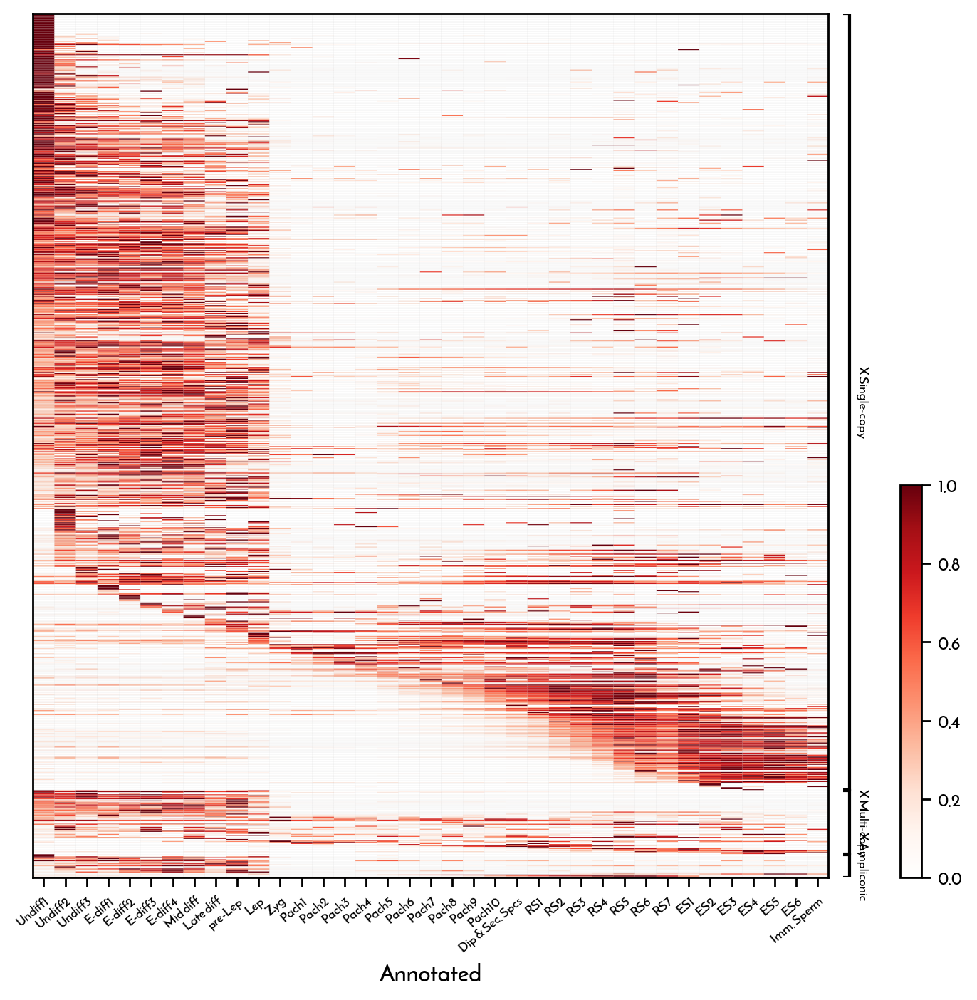

In [221]:
ax = sc.pl.matrixplot(mf_sce_germ, X_sma, groupby="Annotated", figsize=(8,8),standard_scale="var", linewidth=.01,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=False)

#### *X chromsome genes (multi-copy and ampliconic) gene expression*

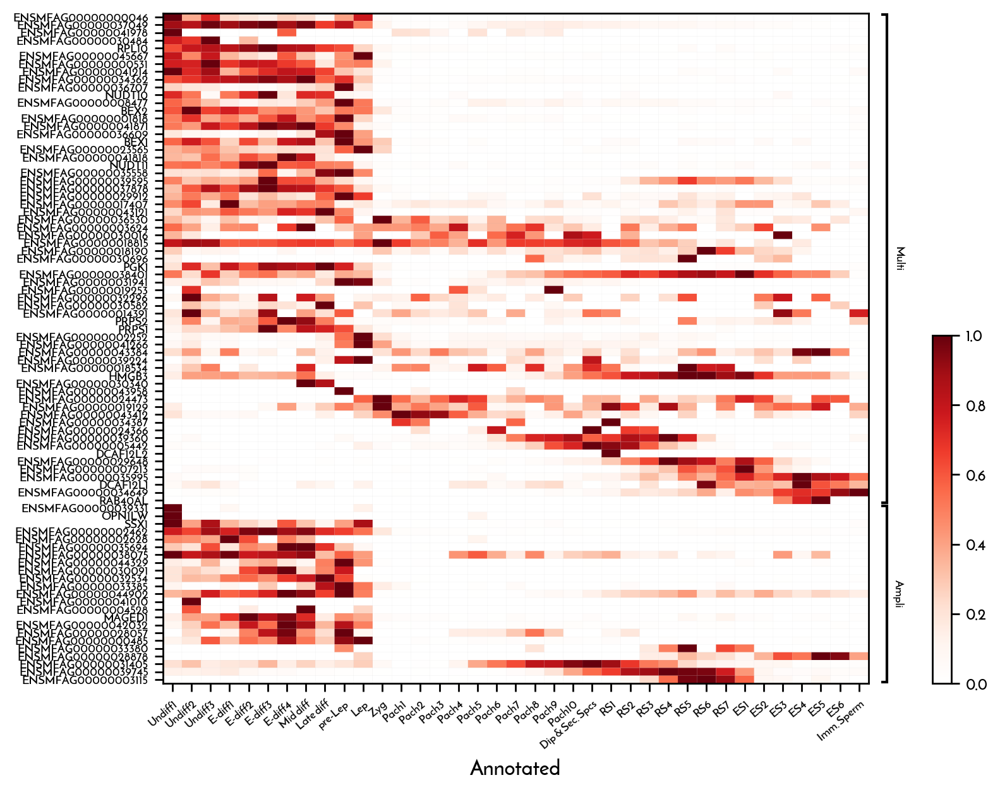

In [222]:
ax = sc.pl.matrixplot(mf_sce_germ, {'Multi':MultiX_unique,'Ampli':Ampli_unique}, groupby="Annotated", figsize=(8,7),standard_scale="var", linewidth=.01,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=True)

In [223]:
Xgenes_mf = Xgenes[Xgenes['gene_short_name'].isin(mf_sce_germ.var['Symbol'])]

In [224]:
Xgenes_mf['gene_class'].value_counts()

SingleCopy    765
MultiCopy      63
Ampliconic     23
Name: gene_class, dtype: int64

In [225]:
pd.crosstab(Xgenes_mf['gene_class'], Xgenes_mf['Shared'])

Shared,NotShared,Shared_hs_mf,Shared_hs_mm_mf
gene_class,,,
Ampliconic,0,12,11
MultiCopy,25,14,24
SingleCopy,137,71,557


In [226]:
MultiX_unique_shared = {}
for i in Xgenes_mf['Shared'].astype('category').cat.categories:
    genes = [x for x in MultiX_unique if x in Xgenes_mf['gene_short_name'][(Xgenes_mf['gene_class']=='MultiCopy') & (Xgenes_mf['Shared']==i)].tolist()]
    MultiX_unique_shared[i] = genes

#### *X chromosome multi-copy gene expression along with its conservation type*

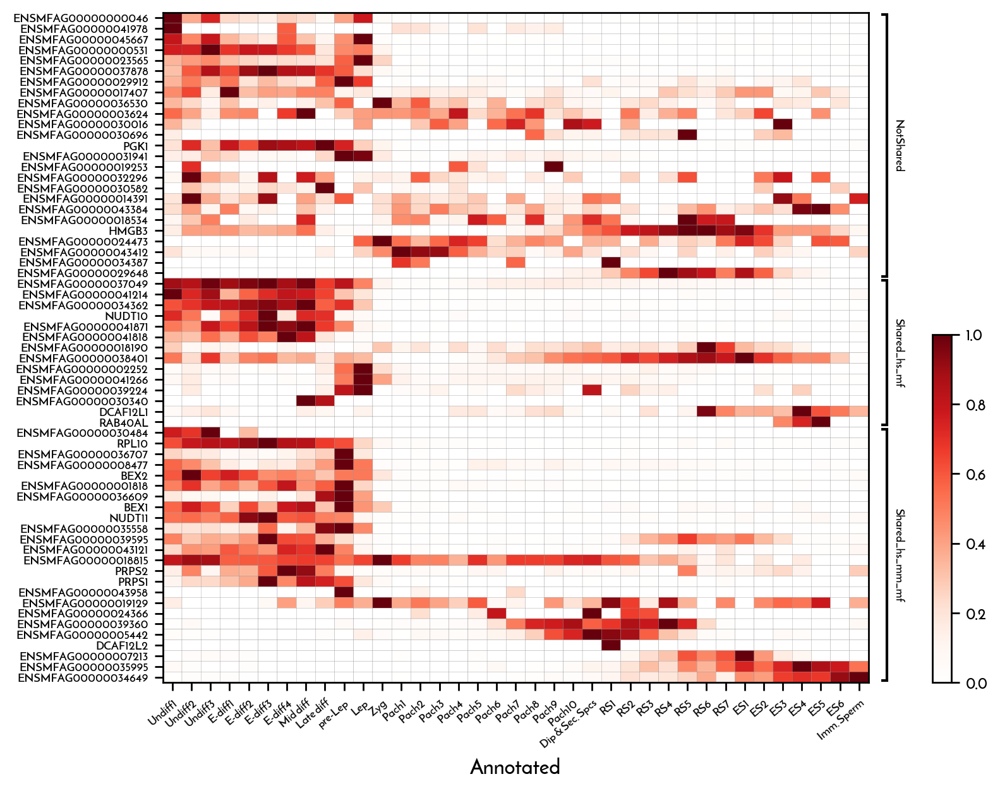

In [227]:
ax = sc.pl.matrixplot(mf_sce_germ, MultiX_unique_shared, groupby="Annotated", figsize=(8,7),standard_scale="var", linewidth=.1,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=True)

In [228]:
AmpliX_unique_shared = {}
for i in Xgenes_mf['Shared'].astype('category').cat.categories:
    genes = [x for x in Ampli_unique if x in Xgenes_mf['gene_short_name'][(Xgenes_mf['gene_class']=='Ampliconic') & (Xgenes_mf['Shared']==i)].tolist()]
    AmpliX_unique_shared[i] = genes

#### *X chromosome ampliconic gene expression along with its conservation type*

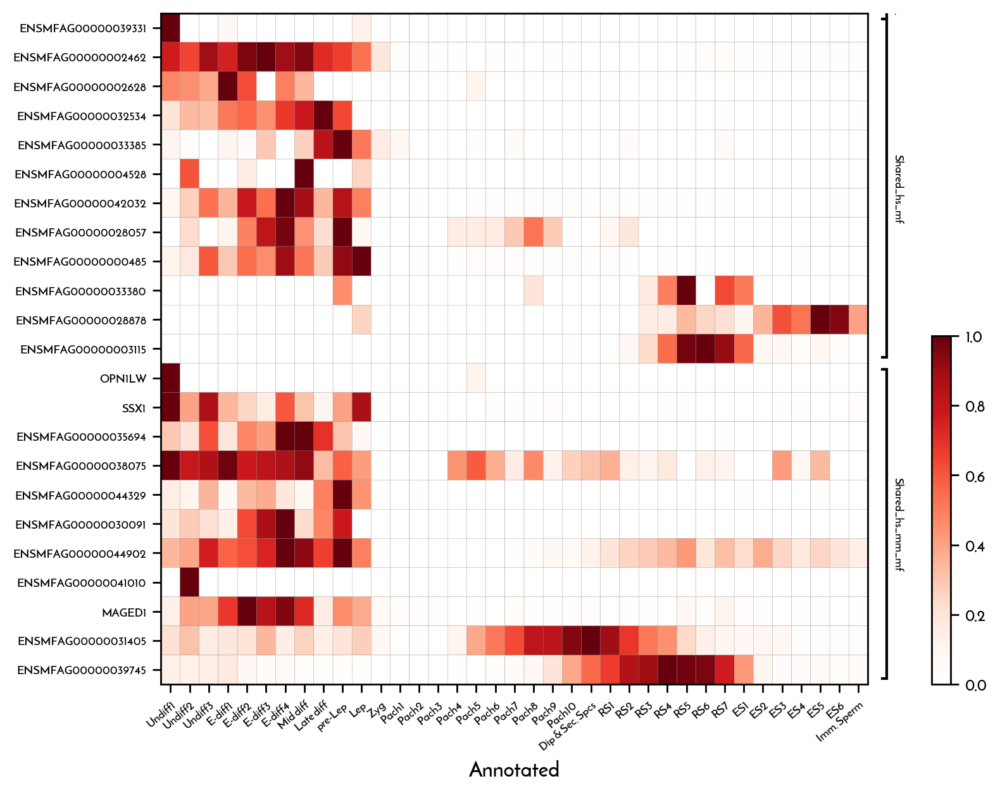

In [229]:
ax = sc.pl.matrixplot(mf_sce_germ, AmpliX_unique_shared, groupby="Annotated", figsize=(8,7),standard_scale="var", linewidth=.1,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=True)

#### *Y chromosome gene expression as dotplot*

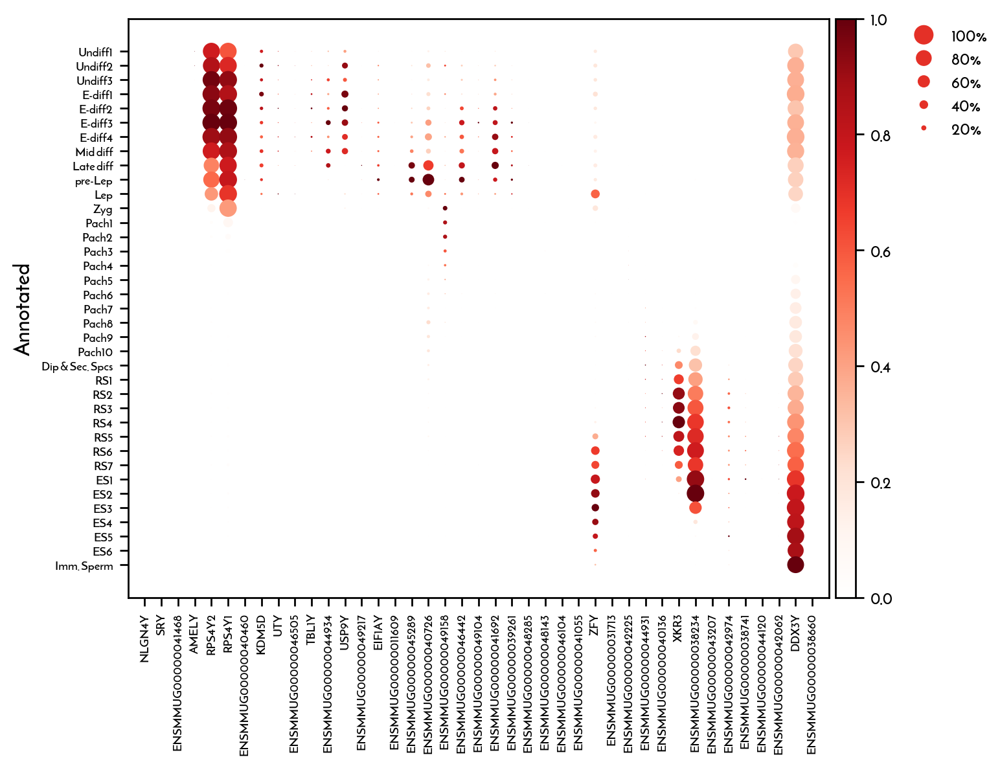

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[7.05, 0, 0.2, 0.5, 0.25])

In [230]:
sc.pl.dotplot(mf_sce_germ,mf_sce_germ.uns['singleY_unique'], groupby="Annotated", figsize=(8,6), standard_scale="var",color_map=heatcolors_wr,
                 dendrogram=False, layer="logcounts")

### *Visualize the number of single/multi/ampliconic genes of Chromosome X expressed across germ cells as pie-chart*

In [233]:
mf_sce_germ.obs['ForPie'] = mf_sce_germ.obs['Annotated']

mf_sce_germ.obs['ForPie'] = mf_sce_germ.obs['ForPie'].replace({
    "Mid diff":"Mid-diff",
    "Late diff":"Late-diff",
    "Dip & Sec. Spcs":"Dip-SecSpcs"
})

In [234]:
X_pie_df = pd.DataFrame(columns=["Unexpressed", "Single-copy", "Multicopy", "Ampliconic"], index=['Undiff1', 'Undiff2', 'Undiff3', 'E-diff1', 'E-diff2', 'E-diff3',
       'E-diff4', 'Mid-diff', 'Late-diff', 'pre-Lep', 'Lep', 'Zyg', 'Pach1',
       'Pach2', 'Pach3', 'Pach4', 'Pach5', 'Pach6', 'Pach7', 'Pach8', 'Pach9',
       'Pach10', 'Dip-SecSpcs', 'RS1', 'RS2', 'RS3', 'RS4', 'RS5', 'RS6',
       'RS7', 'ES1', 'ES2', 'ES3', 'ES4', 'ES5', 'ES6', 'Imm. Sperm'])

In [ ]:
for i in mf_sce_germ.obs['ForPie'].astype('category').cat.categories.tolist():
    df = i+"_df"
    df = mf_sce_germ[mf_sce_germ.obs['ForPie'].isin([i]),:]
    df = df[:,list(germ_Xgenes)]
    sc.pp.filter_genes(df, min_cells=round((df.n_obs*0.05)));
    X_pie_df.loc[i] = [934-df.n_vars, len(df.var['Symbol'][df.var['Symbol'].isin(singleX_unique)]), len(df.var['Symbol'][df.var['Symbol'].isin(MultiX_unique)]), len(df.var['Symbol'][df.var['Symbol'].isin(Ampli_unique)])]

In [236]:
X_pie_df = X_pie_df.div(X_pie_df.sum(axis=1), axis=0)

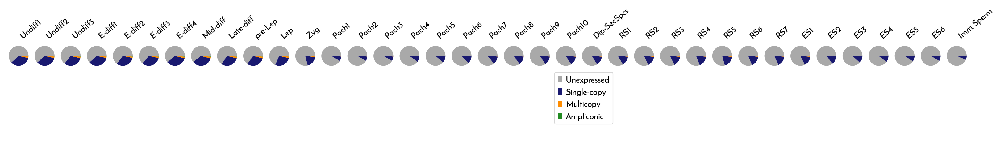

In [237]:
fig, axs = plt.subplots(ncols=37, nrows=1, figsize=(20,3))

fig.subplots_adjust(hspace=0.5, wspace=0.05)
for row, ax in enumerate(axs.flatten()):
    ax.pie(X_pie_df.loc[X_pie_df.index[row],:],radius = 1, labels=None, colors=["darkgrey", "midnightblue", "darkorange", "forestgreen"]) 
    ax.set_title(X_pie_df.index[row], fontsize=10, rotation=40, horizontalalignment='left')
fig.legend(X_pie_df.columns, ncol=1,loc="upper right", bbox_to_anchor=(0.5, 0.4), fontsize=10)
plt.show()

In [238]:
sc.settings.set_figure_params(dpi=100, dpi_save=300, format="pdf")
sns.set_context("paper", font_scale=1, rc={"font.size":6,"axes.labelsize":12,"axes.titlesize":12})

### *Visualising the expression of DDR genes in germ cells*

In [239]:
## Used the term "DNA damage response" in Panther database to retrive DDR genes

In [240]:
sub1 = ['BRCA2', 'MSH3', 'PMS1', 'BAX', 'RPA2', 'XPA', 'TP53BP1', 'MSH2', 'RAD52', 'FANCC', 'XRCC3', 
        'ENSMFAG00000000382', 'BRCA1', 'RECQL4', 'XRCC4', 'RECQL', 'PARP2', 
        'ENSMFAG00000039395', 'RAD51C', 'ENSMFAG00000036138', 'ATM', 'RECQL5', 'ENSMFAG00000033904',
        'RAD21L1', 'NIPBL', 'ATR', 'RAD9B', 'MLH3', 'MSH4', 'MSH6', 'HUS1B', 'RAD17', 'LIG4', 'RAD1', 'XRCC6', 'FANCG', 'RAD51', 
        'XRCC5', 'MLH1', 'RAD9A', 'MDC1', 'MRE11', 'SPO11', 'CBX1', 'H2AFX', 'HORMAD1', 'HORMAD2', 'SETDB1', 'TOPBP1', 'TRIM28']

In [241]:
DDR_sub_unique_sce = mf_sce_germ[:,sub1]

In [242]:
sc.tl.rank_genes_groups(DDR_sub_unique_sce, "Annotated", n_genes=210, method="wilcoxon", layer="logcounts", use_raw=False)

ranking genes


Trying to set attribute `.obs` of view, copying.
... storing 'ForPie' as categorical


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [243]:
L1 = []
for i in DDR_sub_unique_sce.obs["Annotated"].cat.categories:
    genes = sc.get.rank_genes_groups_df(DDR_sub_unique_sce, group=i,log2fc_min=1,pval_cutoff=1, key="rank_genes_groups").sort_values(by="logfoldchanges", ascending=False).dropna(axis=0)["names"].to_list()
    L1.extend(genes) 

In [244]:
sub1_unique = pd.Series(L1).drop_duplicates().tolist()

In [245]:
len(sub1_unique)

50

... storing 'ForPie' as categorical


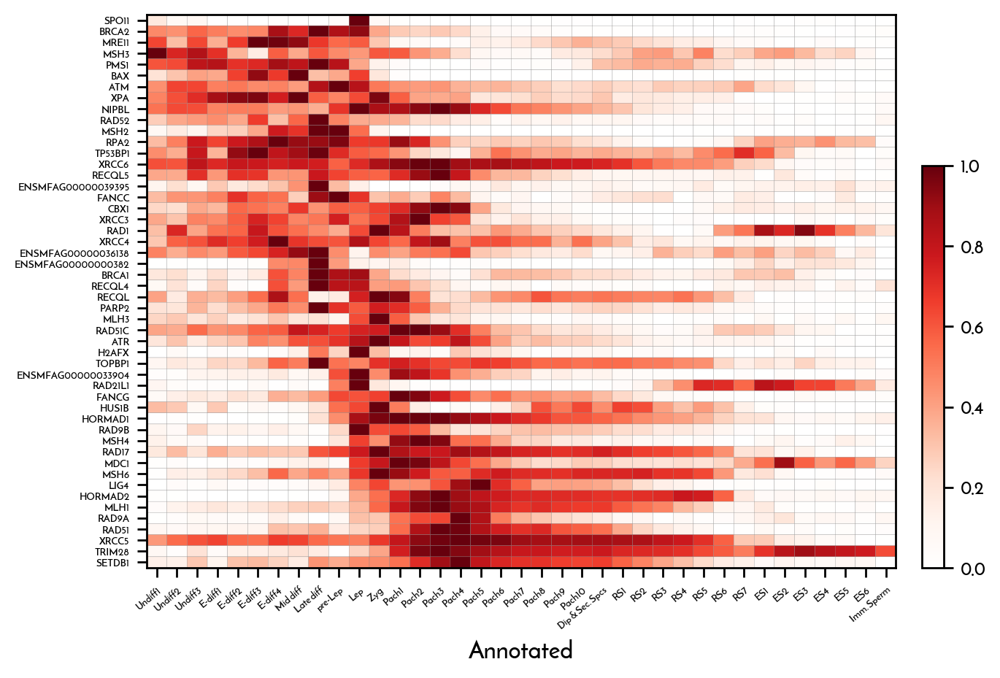

In [246]:
ax = sc.pl.matrixplot(mf_sce_germ,sub1_unique, groupby="Annotated", figsize=(7,5),standard_scale="var", linewidth=.1,swap_axes=True,
                 cmap=heatcolors_wr, dendrogram=False, layer="logcounts", show_gene_labels=True)

### *Visualize the number of ortholog and species-specific genes expressed across germ cells*

In [247]:
mf_unique = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/17Apr_rev/Mf_unique.txt")

In [248]:
Orthologs = pd.read_csv("/home/projects/11001611/working/prabhakaran/RNASeq/Human_Mouse_Monkey_orthologs_21Feb_clean.txt", sep=" ")

In [249]:
Orthologs = Orthologs[(Orthologs.Crab_eating_macaque_homology_type=="ortholog_one2one") & (Orthologs.Mouse_homology_type=="ortholog_one2one")]

In [250]:
mf_ortho_df = pd.DataFrame(columns=["1:1:1 Othologs", "Macaque_specific", "Other orthologs"])

In [ ]:
for i in mf_sce_germ.obs['Annotated'].astype('category').cat.categories.tolist():
    df = i+"_df"
    df = mf_sce_germ[mf_sce_germ.obs['Annotated'].isin([i]),:];
    #df = df[:,list(germ_Xgenes)]
    sc.pp.filter_genes(df, min_cells=round((df.n_obs*0.05)));
    mf_ortho_df.loc[i] = [len(df.var['ID'][df.var['ID'].isin(Orthologs.Crab_eating_macaque_gene_stable_ID.tolist())])/len(df.var['ID'])*100,
                          len(df.var['ID'][df.var['ID'].isin(mf_unique['x'].tolist())])/len(df.var['ID'])*100,
                         len(df.var['ID'][~df.var['ID'].isin(Orthologs.Crab_eating_macaque_gene_stable_ID.tolist()+mf_unique['x'].tolist())])/len(df.var['ID'])*100]

In [252]:
mf_ortho_df['Groups'] = mf_ortho_df.index

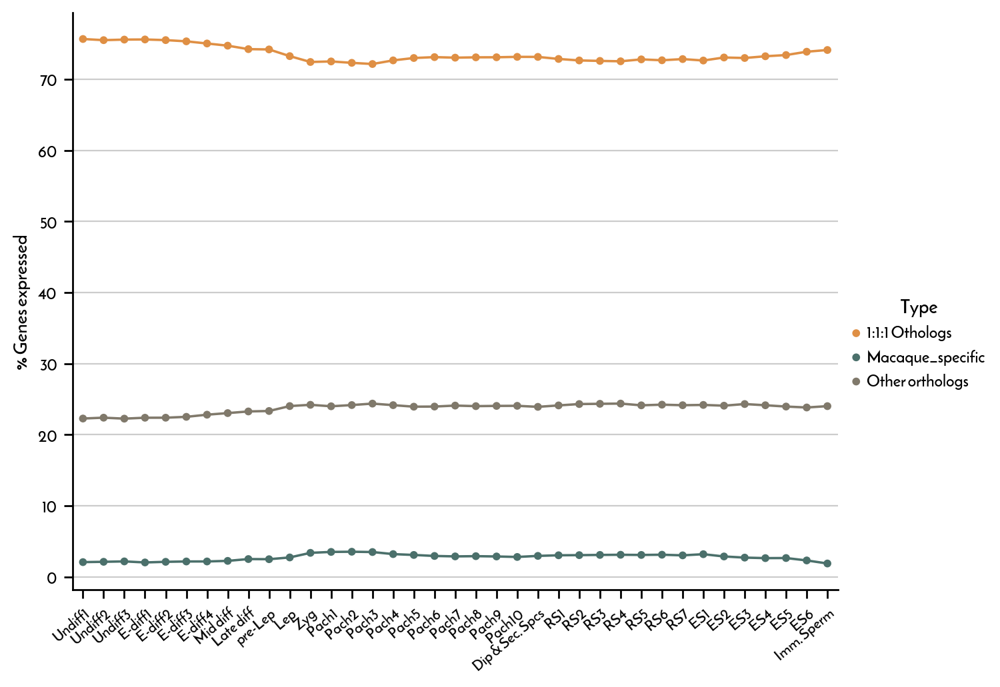

In [253]:
mf_ortho_df_melted = mf_ortho_df.melt('Groups', var_name='Type',  value_name='value')
g=sns.catplot(x="Groups", y="value", hue='Type', data=mf_ortho_df_melted, kind="point",
              palette = ["#DF8F44FF", "#4B706B", "#80796BFF"],s=0.1, height=5, aspect=1.3, scale = 0.6)
plt.xticks(rotation=40, fontsize=8,horizontalalignment="right", rotation_mode="anchor");
plt.xlabel("");
plt.ylabel("% Genes expressed", fontsize=10);